<a href="https://colab.research.google.com/github/AbigailMRod/GANsDL.AI/blob/main/ConditionalGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Construir una GAN condicional

En este cuaderno, se creará una GAN condicional para generar imágenes de dígitos escritas a mano, condicionadas al dígito que se generará (el vector de clase). Esto permitirá elegir qué dígito se desea generar.


## Empezando

Para esta tarea, se volverá a utilizar el conjunto de datos MNIST, pero no hay nada que impida aplicar este código generador para producir imágenes de animales condicionadas por la especie o imágenes de rostros condicionados por las características faciales.

Tenga en cuenta que esta asignación no requiere cambios en las arquitecturas del generador o discriminador, solo cambios en los datos que se pasan a ambos. El generador ya no tomará `z_dim` como argumento, sino `input_dim` en su lugar, ya que necesita pasar tanto el vector de ruido como el de clase. Además de una buena denominación de variables.

Comenzaremos importando las bibliotecas necesarias y construyendo el generador y el discriminador.

#### Paquetes y visualización

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) 

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Función de visualización de imágenes: Dado un tensor de imágenes, número de imágenes y
     tamaño por imagen, traza e imprime las imágenes en una cuadrícula uniforme.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generador y Ruido

In [2]:
class Generator(nn.Module):
    '''
Clase de generador
     Valores:
         input_dim: la dimensión del vector de entrada, un escalar
         im_chan: el número de canales en las imágenes, ajustado para el conjunto de datos utilizado, un escalar
               (MNIST es en blanco y negro, por lo que 1 canal es su valor predeterminado)
         hidden_dim: la dimensión interna, un escalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Construir la red neuronal
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Función para devolver una secuencia de operaciones correspondiente a un bloque generador de DCGAN;
         una convolución transpuesta, una norma por lotes (excepto en la capa final) y una activación.
         Parámetros:
             input_channels: cuántos canales tiene la representación de la característica de entrada
             output_channels: cuántos canales debe tener la representación de la característica de salida
             kernel_size: el tamaño de cada filtro convolucional, equivalente a (kernel_size, kernel_size)
             stride: la zancada de la convolución
             final_layer: un valor booleano, verdadero si es la capa final y falso en caso contrario
                       (afecta la activación y la norma de lote)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Función para completar un paso hacia adelante del generador: Dado un tensor de ruido,
         devuelve las imágenes generadas.
         Parámetros:
             noise: un tensor de ruido con dimensiones (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Función para crear vectores de ruido: Dadas las dimensiones (n_samples, input_dim)
     crea un tensor de esa forma lleno de números aleatorios de la distribución normal.
     Parámetros:
         n_samples: el número de muestras a generar, un escalar
         input_dim: la dimensión del vector de entrada, un escalar
         device: el tipo de dispositivo
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminador

In [3]:
class Discriminator(nn.Module):
    '''
    Clase de discriminador
     Valores:
       im_chan: el número de canales en las imágenes, ajustado para el conjunto de datos utilizado, un escalar
             (MNIST es en blanco y negro, por lo que 1 canal es su valor predeterminado)
       hidden_dim: la dimensión interna, un escalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Función para devolver una secuencia de operaciones correspondiente a un bloque discriminador de la DCGAN;
         una convolución, una norma por lotes (excepto en la capa final) y una activación (excepto en la capa final).
         Parámetros:
             input_channels: cuántos canales tiene la representación de la característica de entrada
             output_channels: cuántos canales debe tener la representación de la característica de salida
             kernel_size: el tamaño de cada filtro convolucional, equivalente a (kernel_size, kernel_size)
             stride: la zancada de la convolución
             final_layer: un valor booleano, verdadero si es la capa final y falso en caso contrario
                       (afecta la activación y la norma de lote)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Función para completar un pase hacia adelante del discriminador: Dado un tensor de imagen,
         devuelve un tensor de 1 dimensión que representa falso/real.
         Parámetros:
             image: un tensor de imagen aplanado con dimensión (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Entrada de clase

En las GAN condicionales, el vector de entrada para el generador también deberá incluir la información de clase. La clase se representa usando un vector codificado one-hot donde su longitud es el número de clases y cada índice representa una clase. El vector es todo 0 y un 1 en la clase elegida. Dadas las etiquetas de varias imágenes (por ejemplo, de un lote) y el número de clases, cree vectores únicos para cada etiqueta. Hay una clase dentro de la biblioteca funcional de PyTorch que puede ayudarte.
<details>

<summary>
<font size="3" color="green">
<b>Consejo opcional para<code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   Este código se puede hacer en una línea.
2.   La documentación para [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) puede ser útil.

</details>

In [4]:
import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Función para crear vectores one-hot para las etiquetas, devuelve un tensor de forma (?, num_classes).
     Parámetros:
         labels: tensor de etiquetas del cargador de datos, tamaño (?)
         n_classes: el número total de clases en el conjunto de datos, un escalar entero
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
# Compruebe que el dispositivo de get_one_hot_labels coincida con el dispositivo de entrada
if torch.cuda.is_available():
    assert str(get_one_hot_labels(torch.Tensor([[0]]).long().cuda(), 1).device).startswith("cuda")
    
print("Success!")

Success!


A continuación, se debe poder concatenar el vector de clase one-hot con el vector de ruido antes de dárselo al generador. También se deberá hacer esto cuando agregue los canales de clase al discriminador.

<details>
<summary>
<font size="3" color="green">
<b>Consejos opcionales para  <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   Este código se puede escribir en una línea
2.   La documentación para [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) puede ser útil.
3.   Específicamente, es posible que desee ver qué hace el argumento `dim` de `torch.cat`.

</details>


In [6]:
def combine_vectors(x, y):
    '''
    Función para combinar dos vectores con formas (n_muestras, ?) y (n_muestras, ?).
     Parámetros:
       x: (n_muestras, ?) el primer vector.
         En esta asignación, este será el vector de ruido de forma (n_samples, z_dim),
         pero no debería necesitar saber el tamaño de la segunda dimensión.
       y: (n_muestras, ?) el segundo vector.
         Una vez más, en esta tarea, este será el vector de clase one-hot
         con la forma (n_samples, n_classes), pero no debe asumir esto en su código.
    '''
    # Nota: asegúrese de que esta función genere un flotante sin importar las entradas que reciba
    #### START CODE HERE ####
    combined = torch.cat([x.float(), y.float()],dim=1) 
    #### END CODE HERE ####
    return combined

In [7]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]))
if torch.cuda.is_available():
    # Revisa que no rompa con cuda
    cuda_check = combine_vectors(torch.tensor([[1, 2], [3, 4]]).cuda(), torch.tensor([[5, 6], [7, 8]]).cuda())
    assert str(cuda_check.device).startswith("cuda")
# Comprobar el orden exacto de los elementos
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Comprueba que los elementos son de tipo flotante
assert (type(combined[0][0].item()) == float)
# Comprobar formas
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
# Verifique que la transformación flotante no ocurra después de concatenar las entradas
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12)).shape) == (1, 30, 12)
print("Success!")

Success!


## Entrenamiento
¡Ya se puede empezar a combinar todo!
Primero, se definirán algunos parámetros nuevos:

* mnist_shape: el número de píxeles en cada imagen MNIST, que tiene unas dimensiones de 28 x 28 y un canal (porque es en blanco y negro), por lo que 1 x 28 x 28
* n_classes: el número de clases en MNIST (10, ya que están los dígitos del 0 al 9)

In [8]:
mnist_shape = (1, 28, 28)
n_classes = 10

Y también incluye los mismos parámetros de asignaciones anteriores:

   * criterion: la función de pérdida
   * n_epochs: la cantidad de veces que itera a través de todo el conjunto de datos durante el entrenamiento
   * z_dim: la dimensión del vector de ruido
   * display_step: con qué frecuencia mostrar/visualizar las imágenes
   * tamaño_lote: el número de imágenes por paso adelante/atrás
   * lr: la tasa de aprendizaje
   * device: el tipo de dispositivo

In [9]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=True, transform=transform),
    batch_size=batch_size,
    shuffle=True)

  0%|          | 0/9912422 [00:00<?, ?it/s]

Extracting ./MNIST/raw/train-images-idx3-ubyte.gz to ./MNIST/raw



  0%|          | 0/28881 [00:00<?, ?it/s]

Extracting ./MNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST/raw



  0%|          | 0/1648877 [00:00<?, ?it/s]

Extracting ./MNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST/raw



  0%|          | 0/4542 [00:00<?, ?it/s]

Extracting ./MNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST/raw



Luego, puede inicializar su generador, discriminador y optimizadores. Para hacer esto, deberá actualizar las dimensiones de entrada para ambos modelos. Para el generador, deberá calcular el tamaño del vector de entrada; recuerde que para las GAN condicionales, la entrada del generador es el vector de ruido concatenado con el vector de clase. Para el discriminador, debe agregar un canal para cada clase.

In [10]:
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Función para obtener el tamaño de las dimensiones de entrada condicional
     de z_dim, la forma de la imagen y el número de clases.
     Parámetros:
         z_dim: la dimensión del vector de ruido, un escalar
         mnist_shape: la forma de cada imagen MNIST como (C, W, H), que es (1, 28, 28)
         n_classes: el número total de clases en el conjunto de datos, un escalar entero
                 (10 para MNIST)
     Devoluciones:
         generator_input_dim: la dimensionalidad de entrada del generador condicional,
                           que toma los vectores de ruido y clase
         discriminator_im_chan: el número de canales de entrada al discriminador
                             (por ejemplo, C x 28 x 28 para MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [11]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [12]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Ahora, para entrenar, le gustaría que tanto su generador como su discriminador supieran qué clase de imagen debe generarse. Hay algunas ubicaciones en las que necesitará implementar código.

Por ejemplo, si está generando una imagen del número "1", necesitará:
  
1. Dígale eso al generador, para que sepa que debería estar generando un "1"
2. Dígale eso al discriminador, para que sepa que debe estar mirando un "1". Si se le dice al discriminador que debería estar mirando un 1 pero ve algo que claramente es un 8, puede adivinar que probablemente sea falso.

No hay pruebas unitarias explícitas aquí; si este bloque de código se ejecuta y no cambia ninguna de las otras variables, ¡entonces lo ha hecho correctamente!

  0%|          | 0/469 [00:00<?, ?it/s]

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 1, step 500: Generator loss: 2.219214700579643, discriminator loss: 0.2481151719763875


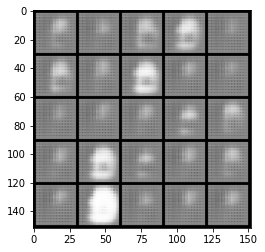

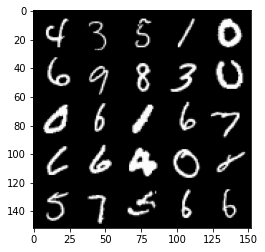

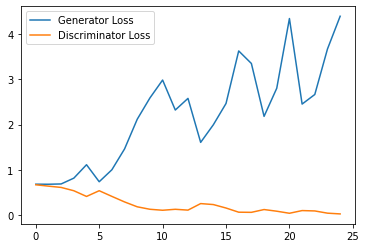

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 2, step 1000: Generator loss: 4.29963831615448, discriminator loss: 0.047709296932443974


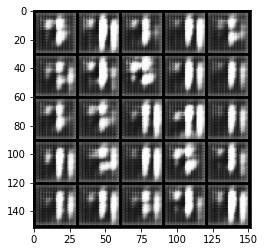

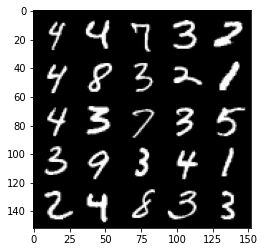

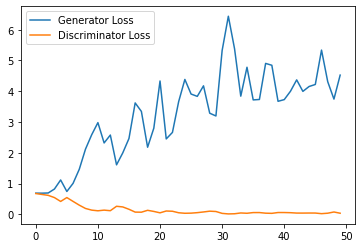

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 3, step 1500: Generator loss: 4.140002752780914, discriminator loss: 0.05395505426637828


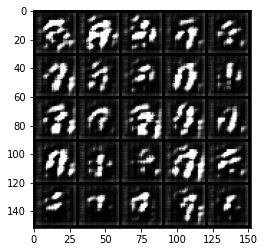

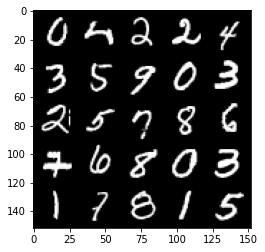

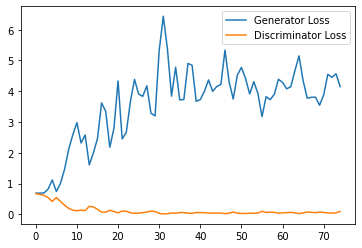

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 4, step 2000: Generator loss: 2.670214105129242, discriminator loss: 0.2162200196608901


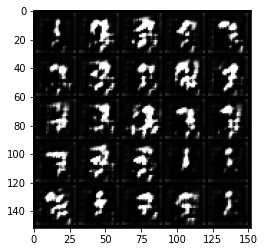

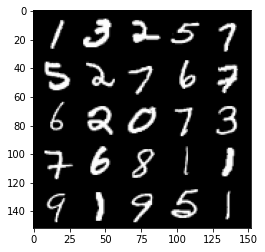

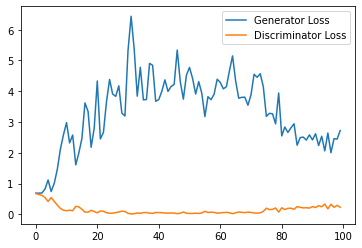

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 5, step 2500: Generator loss: 2.344674486398697, discriminator loss: 0.3082047463059425


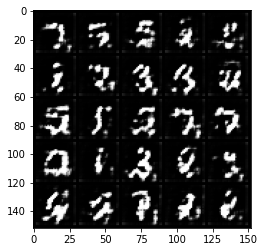

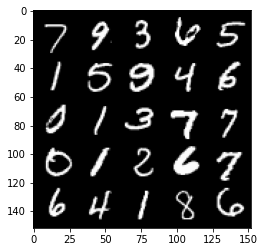

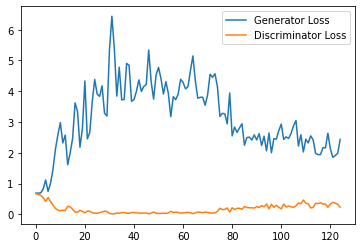

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 6, step 3000: Generator loss: 1.9559242618083954, discriminator loss: 0.33977238985896113


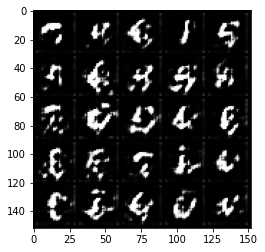

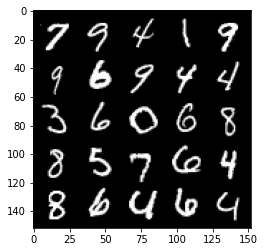

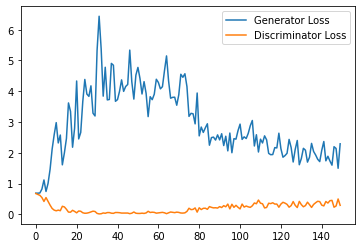

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 7, step 3500: Generator loss: 1.8911953892707825, discriminator loss: 0.3574763984978199


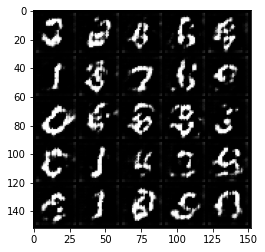

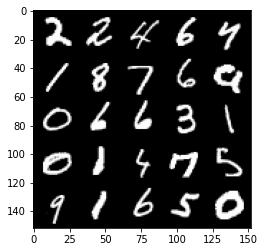

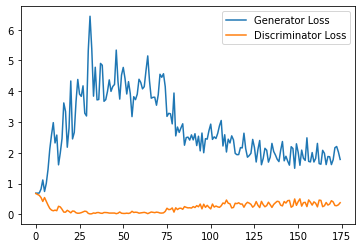

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 8, step 4000: Generator loss: 1.9019049741029739, discriminator loss: 0.37446515369415284


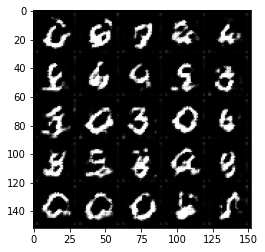

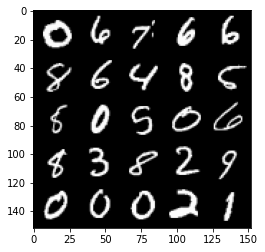

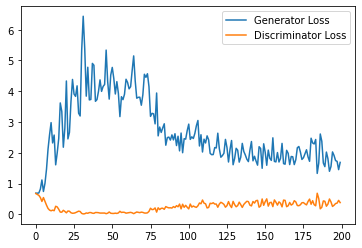

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 9, step 4500: Generator loss: 1.7526026284694671, discriminator loss: 0.39640356540679933


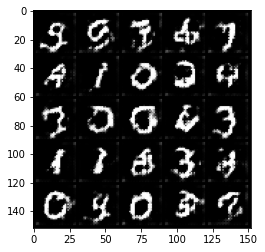

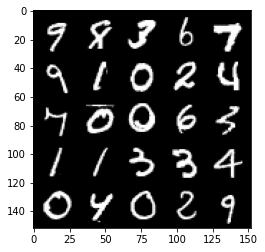

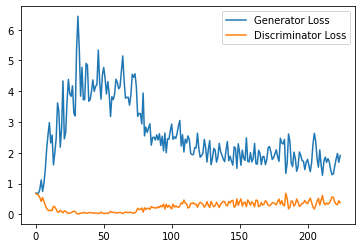

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 10, step 5000: Generator loss: 1.8188041532039643, discriminator loss: 0.4162730362713337


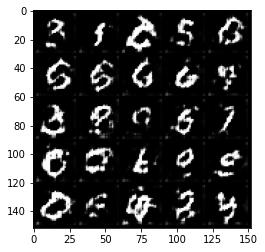

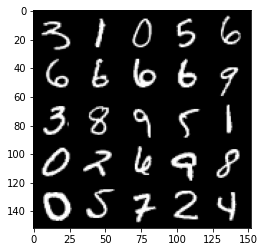

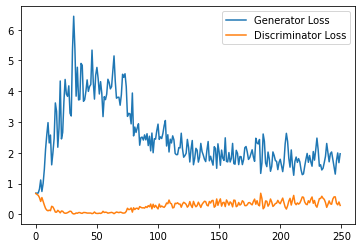

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 11, step 5500: Generator loss: 1.527670254945755, discriminator loss: 0.42874467945098876


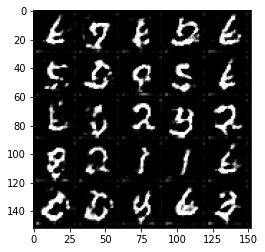

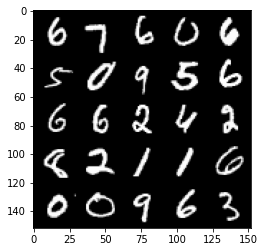

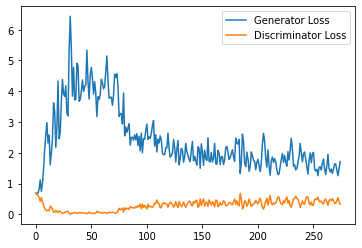

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 12, step 6000: Generator loss: 1.5637872970104219, discriminator loss: 0.4463865447044373


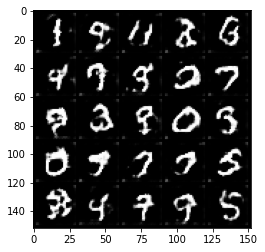

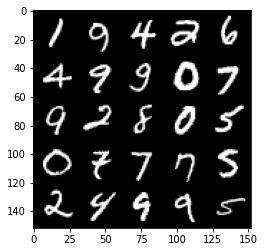

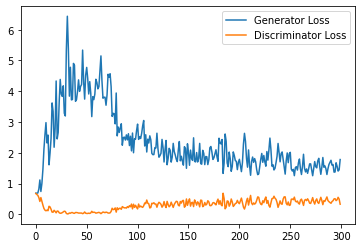

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 13, step 6500: Generator loss: 1.41152683198452, discriminator loss: 0.477319476723671


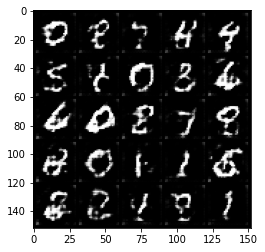

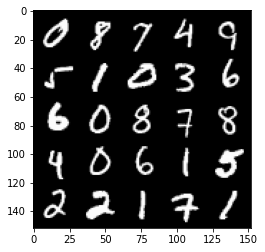

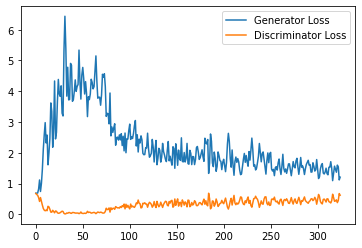

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 14, step 7000: Generator loss: 1.390737637400627, discriminator loss: 0.46661514455080033


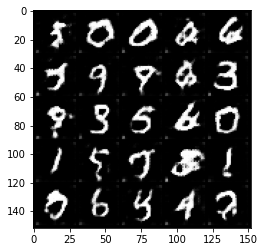

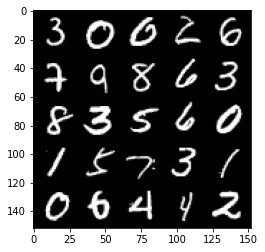

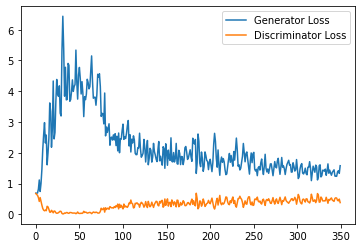

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 15, step 7500: Generator loss: 1.3182269504070283, discriminator loss: 0.5130629636049271


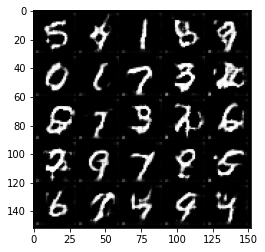

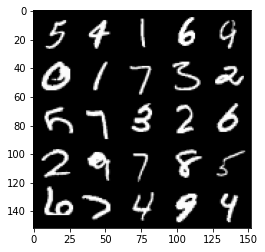

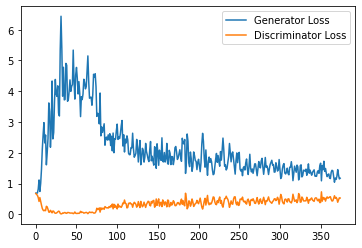

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 17, step 8000: Generator loss: 1.3026689656972885, discriminator loss: 0.5165881707072258


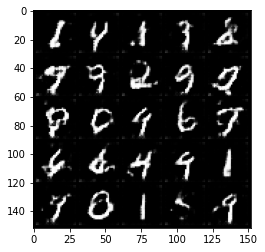

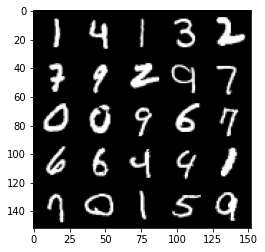

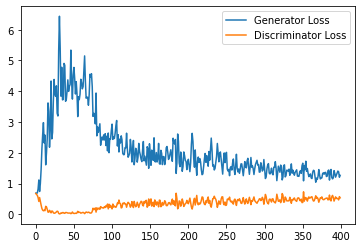

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 18, step 8500: Generator loss: 1.2626189445257188, discriminator loss: 0.539132401585579


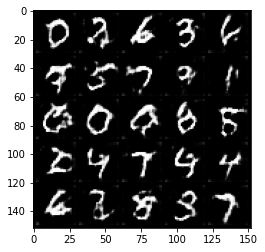

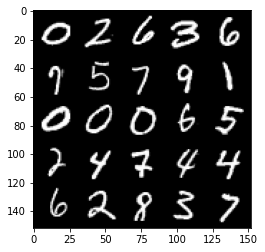

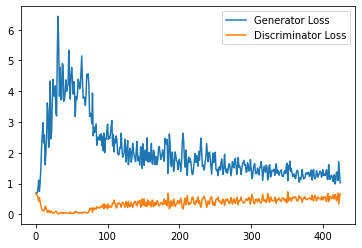

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 19, step 9000: Generator loss: 1.189541025876999, discriminator loss: 0.5429691792726516


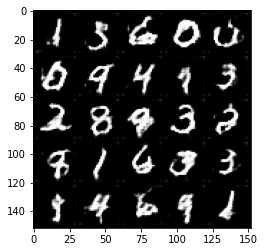

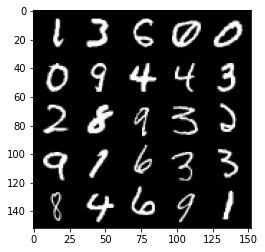

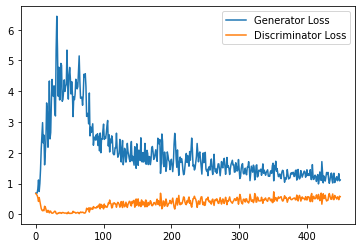

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 20, step 9500: Generator loss: 1.2484944603443147, discriminator loss: 0.5370444251894951


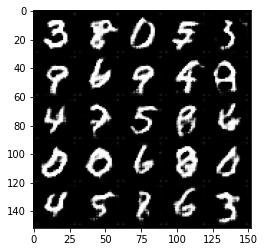

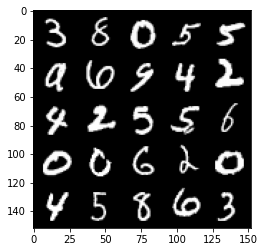

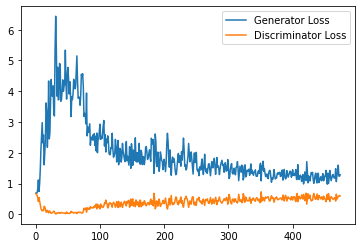

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 21, step 10000: Generator loss: 1.284318701148033, discriminator loss: 0.5492631174921989


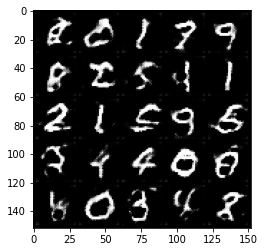

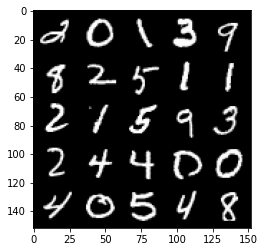

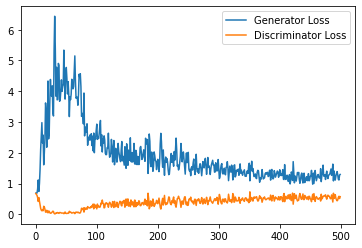

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 22, step 10500: Generator loss: 1.0881804299354554, discriminator loss: 0.5769574264287949


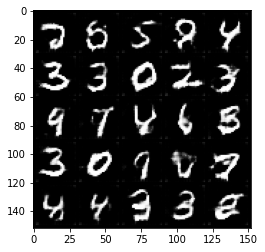

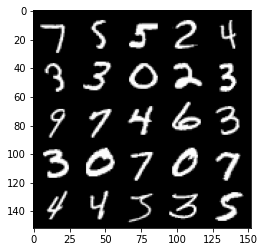

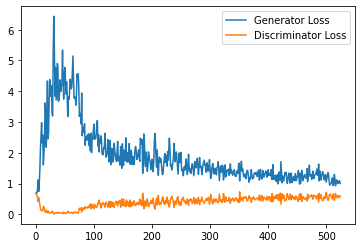

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 23, step 11000: Generator loss: 1.072307013273239, discriminator loss: 0.5880625077486038


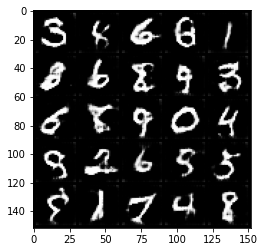

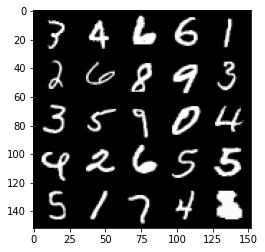

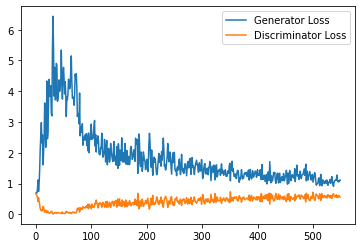

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 24, step 11500: Generator loss: 1.1133542324304582, discriminator loss: 0.5851166605949402


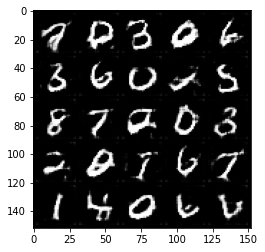

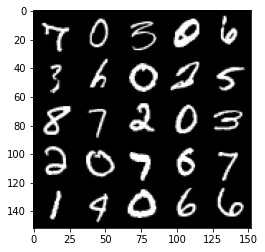

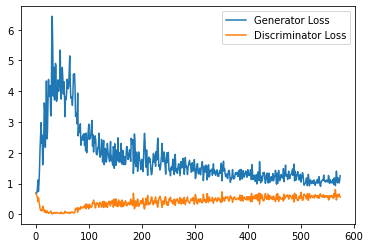

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 25, step 12000: Generator loss: 1.0824421966075897, discriminator loss: 0.5793158806562424


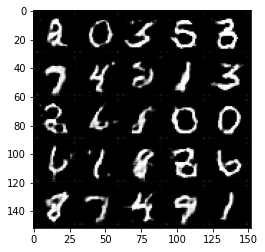

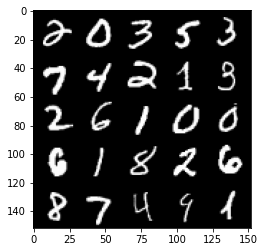

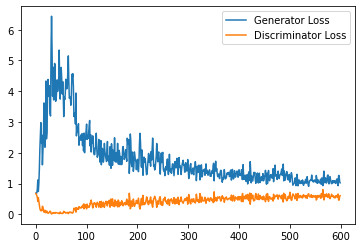

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 26, step 12500: Generator loss: 1.0212275580167771, discriminator loss: 0.5893148695230483


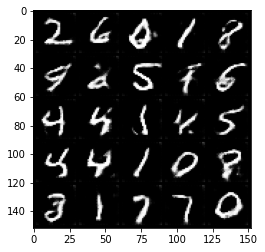

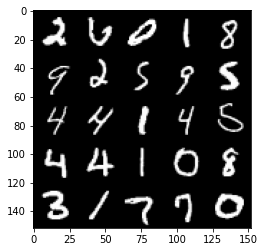

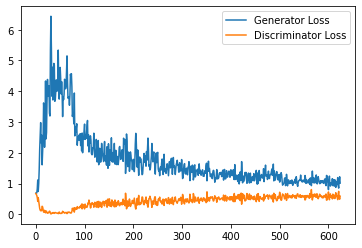

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 27, step 13000: Generator loss: 1.0652344788312913, discriminator loss: 0.5975286168456078


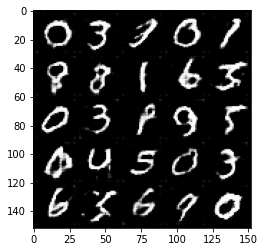

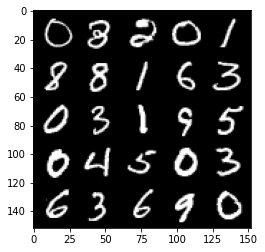

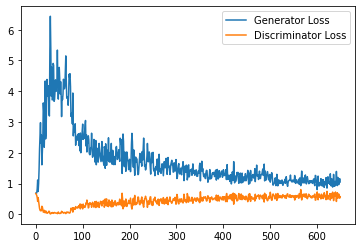

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 28, step 13500: Generator loss: 1.037748305082321, discriminator loss: 0.6010597897171974


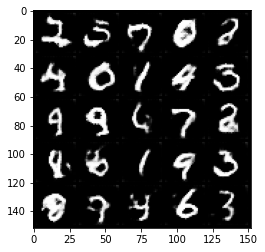

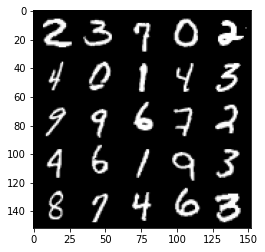

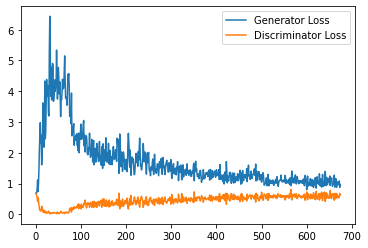

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 29, step 14000: Generator loss: 1.0102180441617965, discriminator loss: 0.5914653160572052


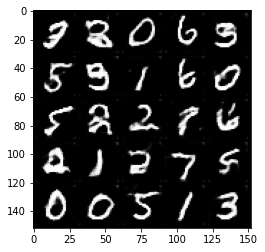

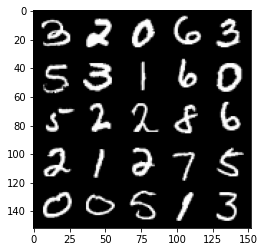

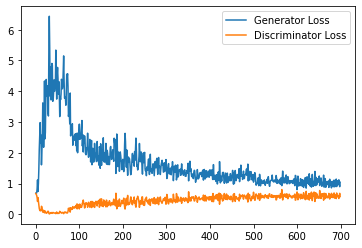

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 30, step 14500: Generator loss: 1.0189817883968353, discriminator loss: 0.5952351351976395


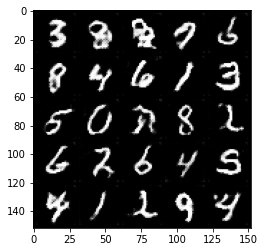

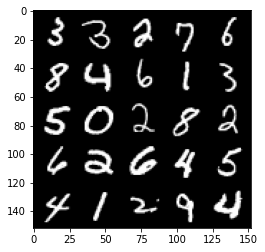

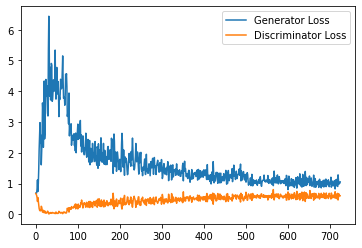

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 31, step 15000: Generator loss: 1.0424936392307282, discriminator loss: 0.5913353980183601


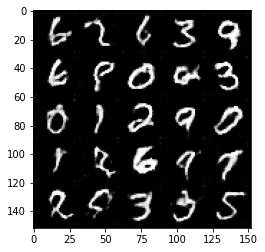

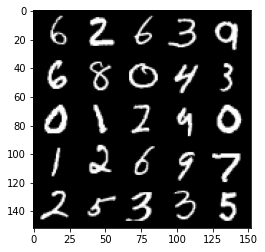

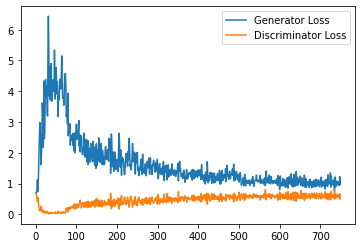

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 33, step 15500: Generator loss: 1.0764917719364167, discriminator loss: 0.5866215851902962


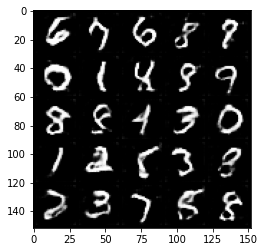

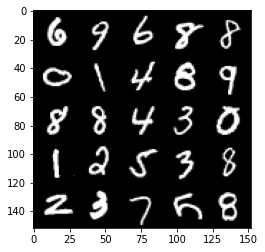

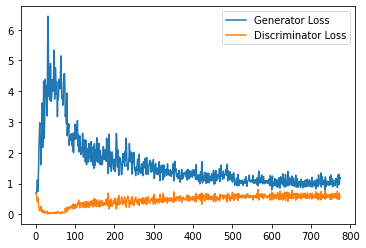

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 34, step 16000: Generator loss: 1.0360394965410233, discriminator loss: 0.5894722786545753


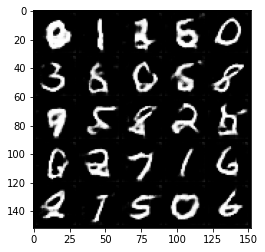

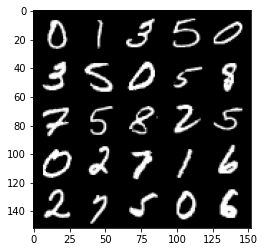

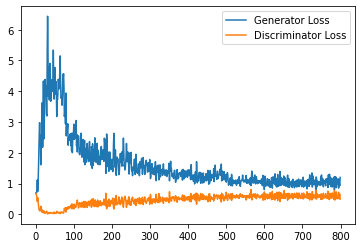

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 35, step 16500: Generator loss: 1.0653408353328704, discriminator loss: 0.586384259045124


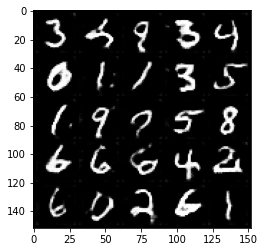

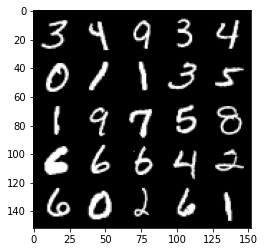

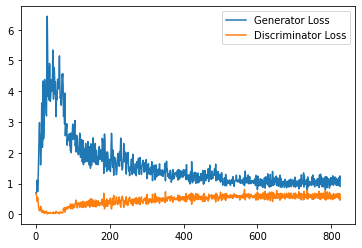

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 36, step 17000: Generator loss: 1.0298902173042297, discriminator loss: 0.5835821664333344


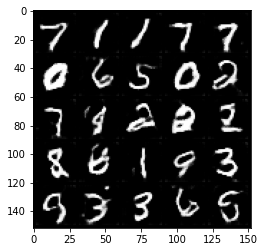

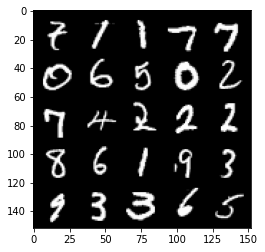

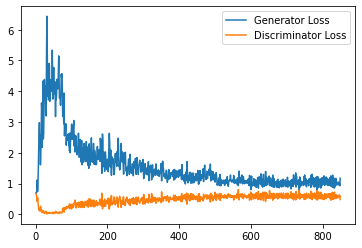

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 37, step 17500: Generator loss: 1.001460013628006, discriminator loss: 0.5917981175780296


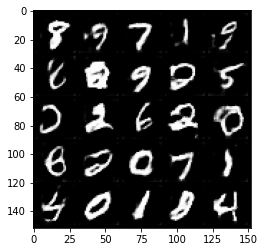

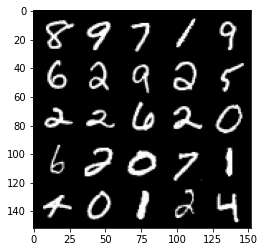

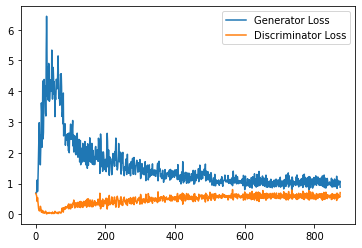

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 38, step 18000: Generator loss: 1.0342104682922364, discriminator loss: 0.5793954329490661


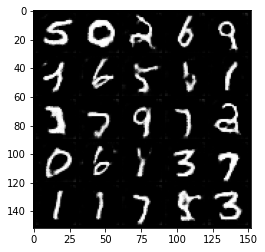

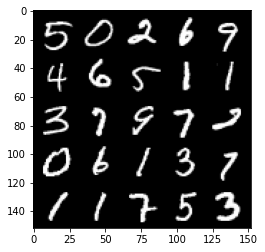

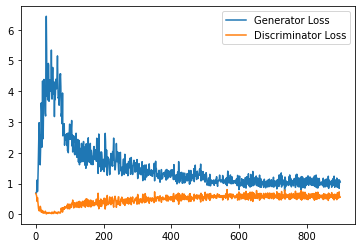

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 39, step 18500: Generator loss: 1.0251439946889878, discriminator loss: 0.5957439611554146


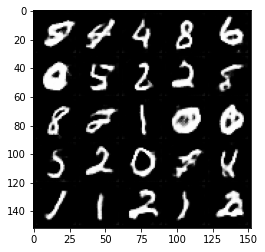

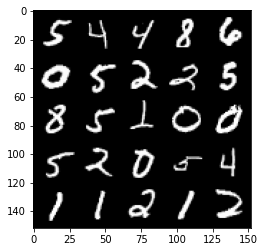

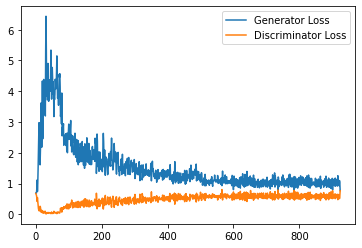

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 40, step 19000: Generator loss: 1.0118071632385255, discriminator loss: 0.5871707202196121


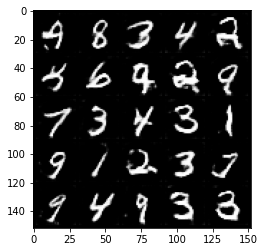

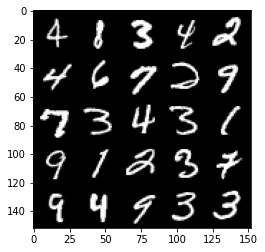

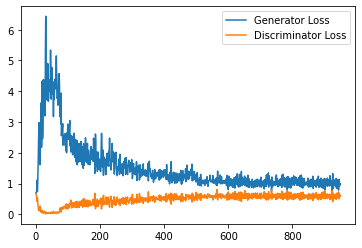

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 41, step 19500: Generator loss: 1.0333989068269729, discriminator loss: 0.5875959084033966


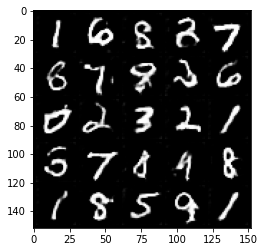

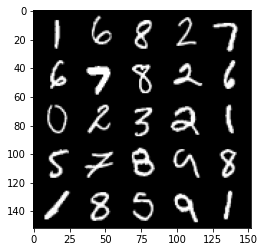

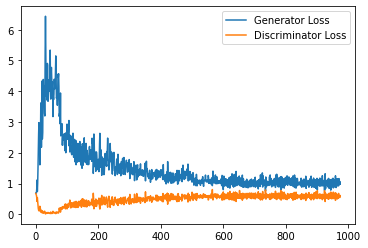

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 42, step 20000: Generator loss: 1.0058439387083054, discriminator loss: 0.5918264258503914


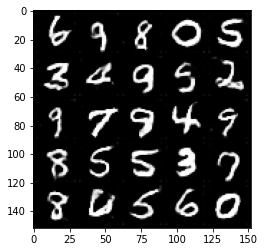

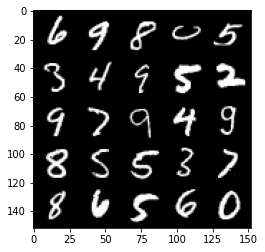

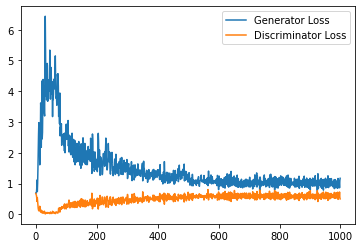

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 43, step 20500: Generator loss: 1.0028527619838714, discriminator loss: 0.5957838966250419


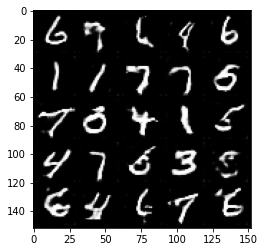

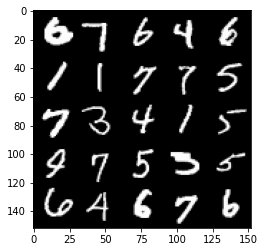

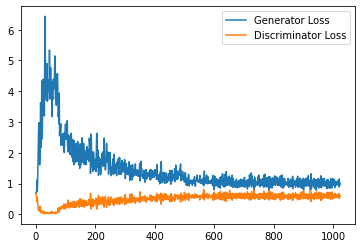

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 44, step 21000: Generator loss: 1.003378634929657, discriminator loss: 0.5945304167270661


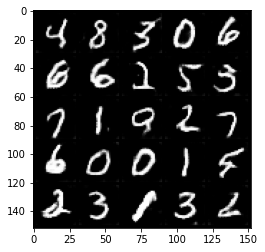

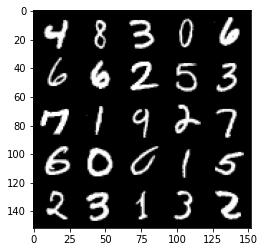

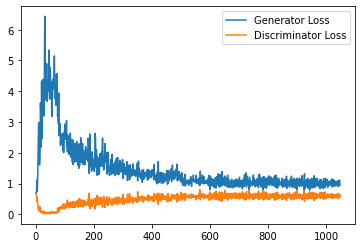

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 45, step 21500: Generator loss: 1.0031742506027221, discriminator loss: 0.5863941163420677


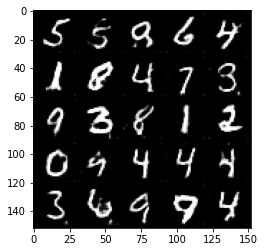

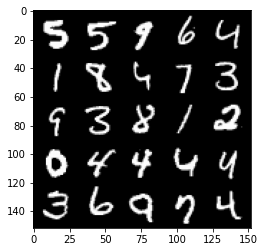

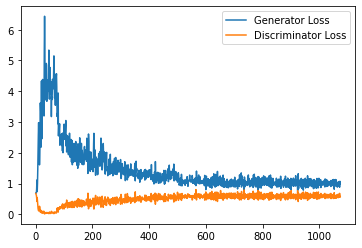

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 46, step 22000: Generator loss: 1.0044362024068831, discriminator loss: 0.5991942746043205


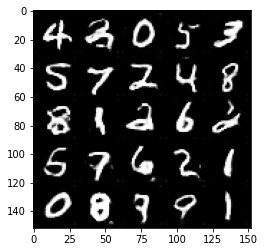

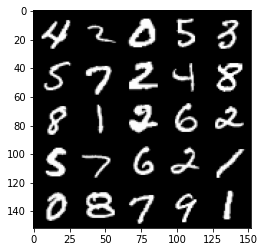

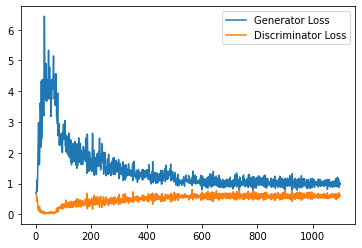

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 47, step 22500: Generator loss: 0.9965621836185455, discriminator loss: 0.6032416896820069


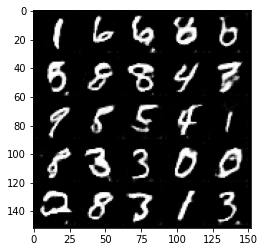

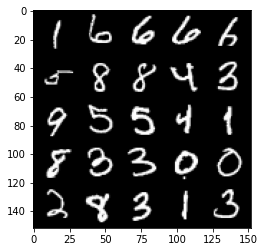

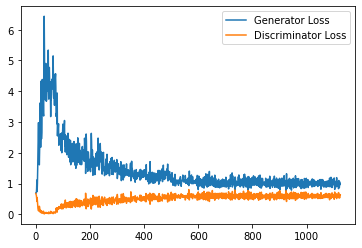

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 49, step 23000: Generator loss: 0.9926039335727692, discriminator loss: 0.5970350321531296


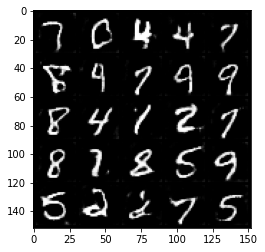

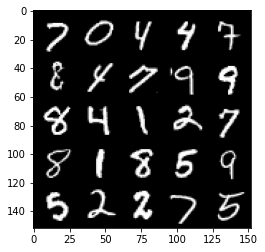

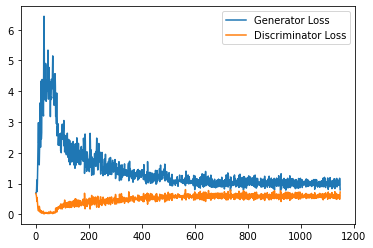

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 50, step 23500: Generator loss: 0.9917173569202423, discriminator loss: 0.5942697301506996


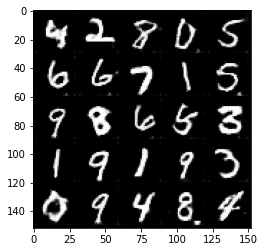

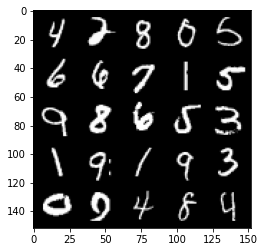

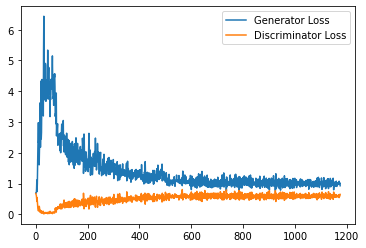

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 51, step 24000: Generator loss: 0.9969829661846161, discriminator loss: 0.595741397023201


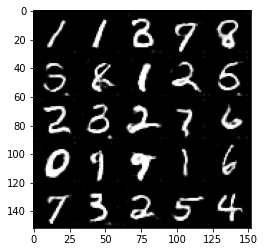

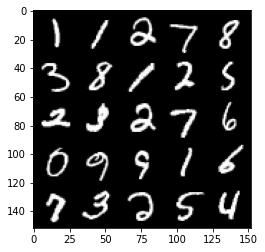

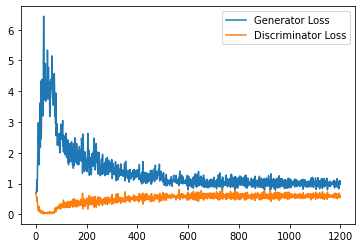

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 52, step 24500: Generator loss: 0.9803844970464707, discriminator loss: 0.5979662110805511


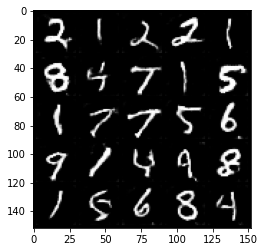

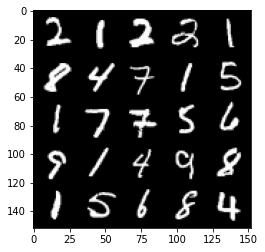

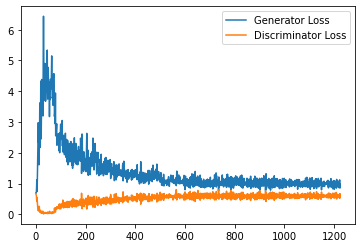

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 53, step 25000: Generator loss: 0.9768576666116714, discriminator loss: 0.5984230258464813


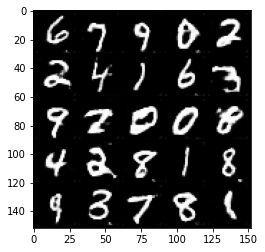

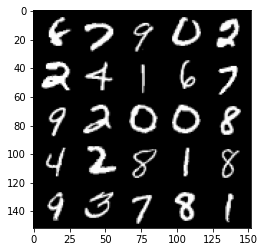

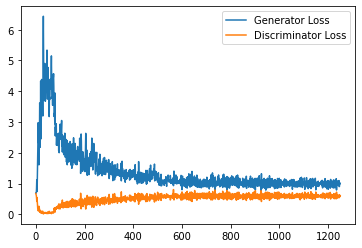

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 54, step 25500: Generator loss: 0.9816439259052276, discriminator loss: 0.5998158534765243


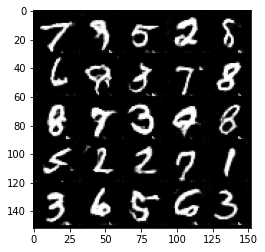

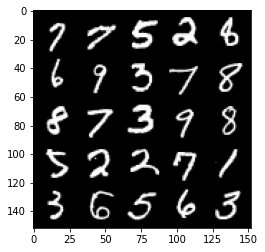

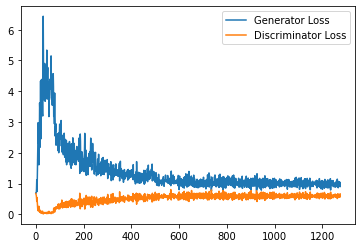

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 55, step 26000: Generator loss: 0.9994267988204956, discriminator loss: 0.598216838657856


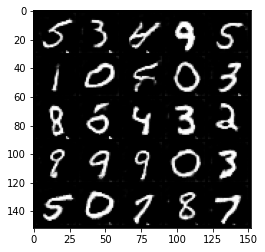

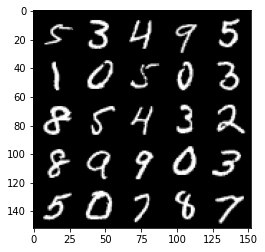

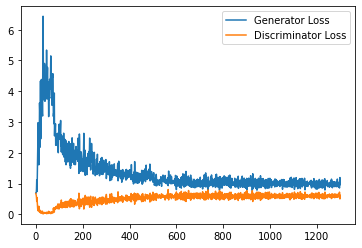

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 56, step 26500: Generator loss: 0.9816792712211609, discriminator loss: 0.605417306125164


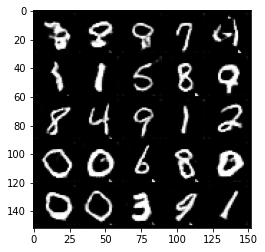

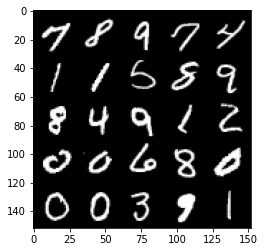

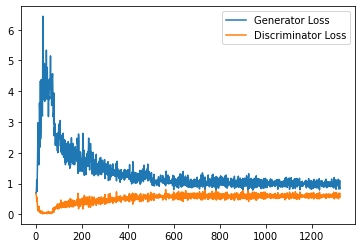

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 57, step 27000: Generator loss: 0.9873442628383636, discriminator loss: 0.6014249575138092


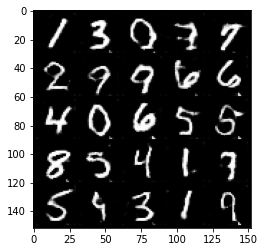

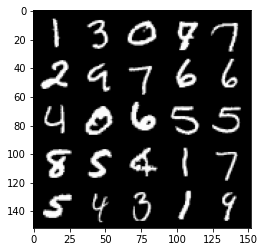

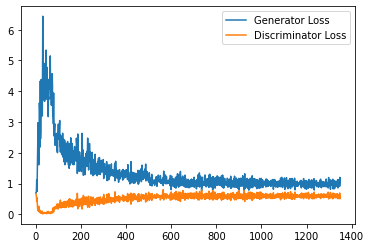

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 58, step 27500: Generator loss: 0.9786007668972015, discriminator loss: 0.6080966891646385


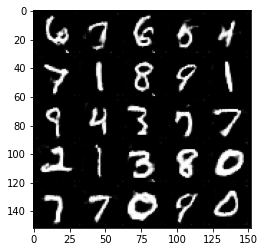

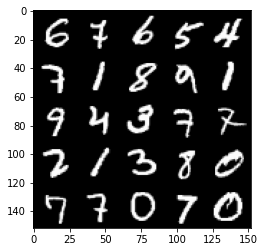

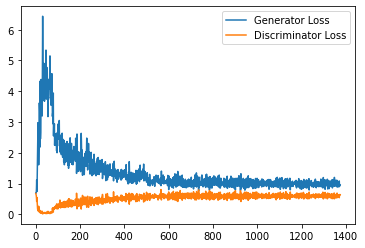

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 59, step 28000: Generator loss: 0.9653411061763764, discriminator loss: 0.6002834351658821


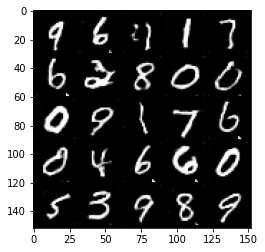

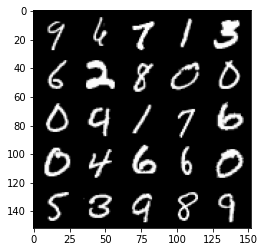

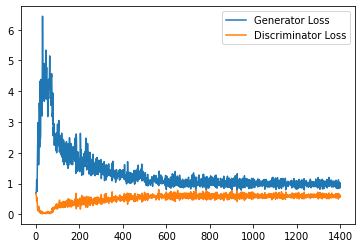

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 60, step 28500: Generator loss: 0.9545614451169968, discriminator loss: 0.6032028115987778


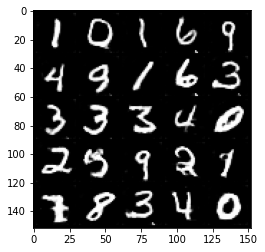

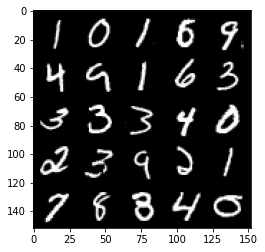

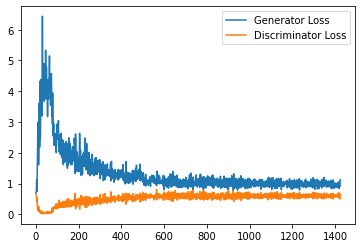

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 61, step 29000: Generator loss: 0.947302875995636, discriminator loss: 0.6056226063370704


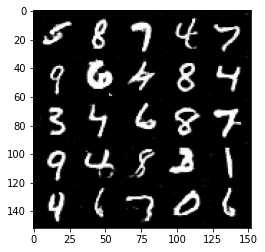

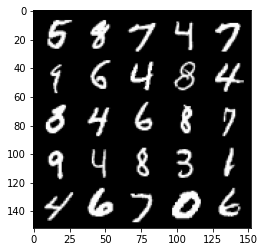

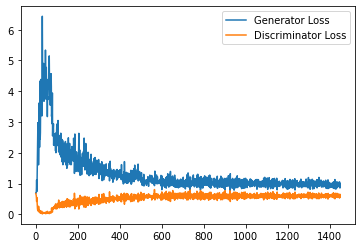

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 62, step 29500: Generator loss: 0.9716691905260086, discriminator loss: 0.6022456237673759


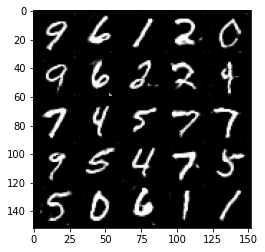

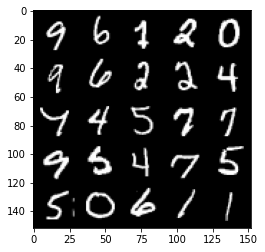

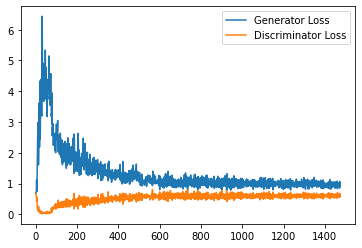

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 63, step 30000: Generator loss: 0.9959165394306183, discriminator loss: 0.6009979944825172


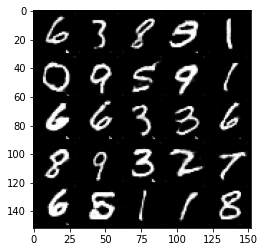

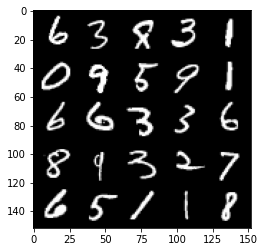

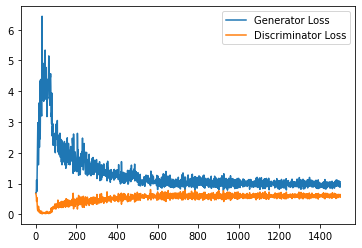

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 65, step 30500: Generator loss: 0.982196542263031, discriminator loss: 0.6057749495506287


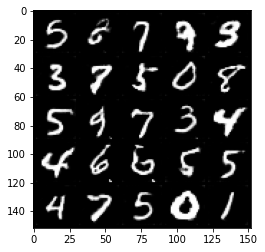

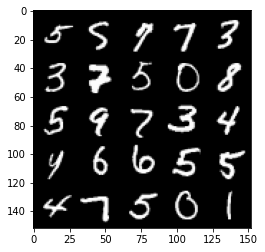

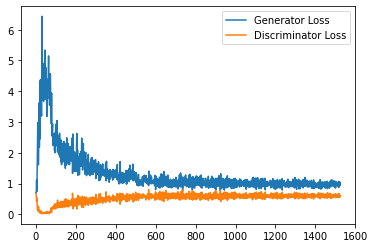

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 66, step 31000: Generator loss: 0.9771054037809372, discriminator loss: 0.6038053934574127


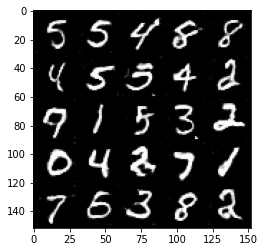

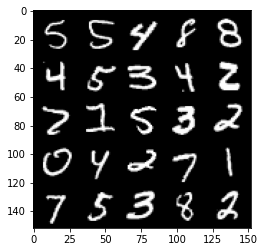

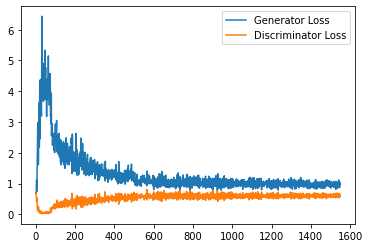

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 67, step 31500: Generator loss: 0.9634711455106735, discriminator loss: 0.6060821613073349


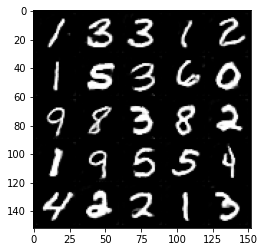

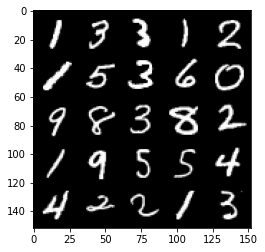

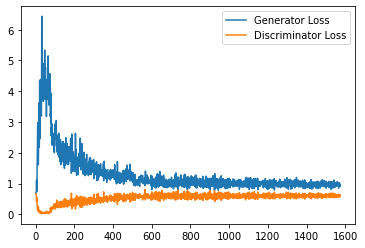

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 68, step 32000: Generator loss: 0.9520514993667603, discriminator loss: 0.6059056401252747


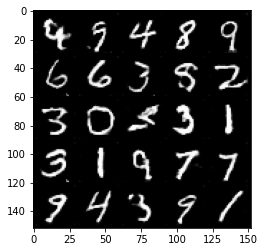

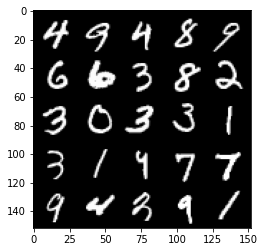

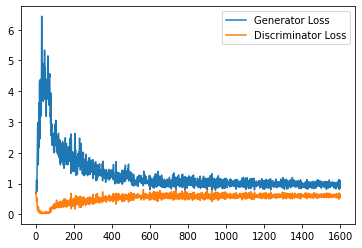

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 69, step 32500: Generator loss: 0.9489317954778671, discriminator loss: 0.6066498330831528


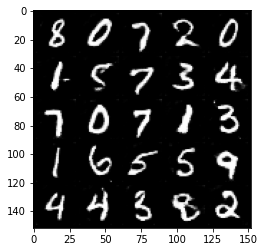

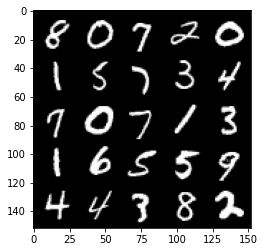

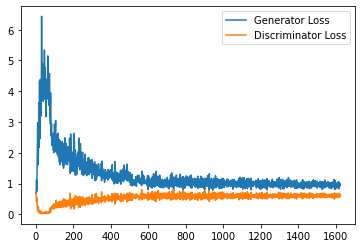

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 70, step 33000: Generator loss: 0.9719392839670181, discriminator loss: 0.5988232287764549


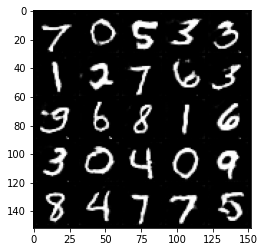

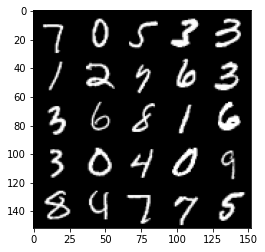

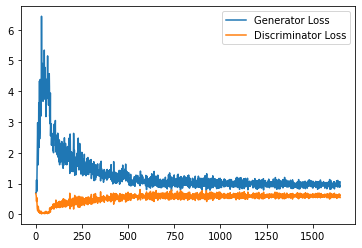

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 71, step 33500: Generator loss: 0.9736874290704727, discriminator loss: 0.6032402993440628


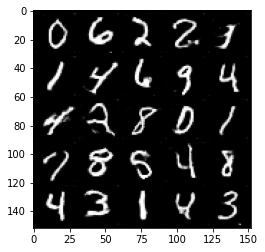

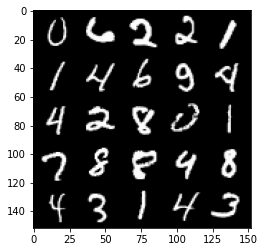

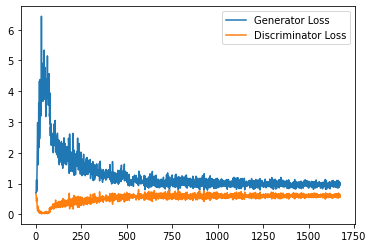

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 72, step 34000: Generator loss: 0.955790607213974, discriminator loss: 0.6061895141005516


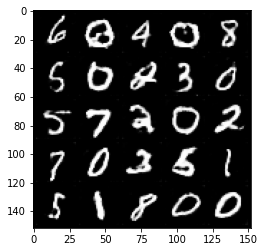

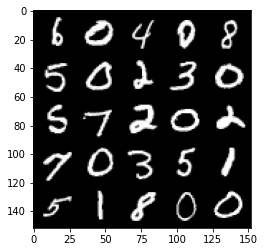

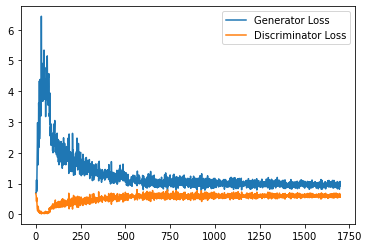

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 73, step 34500: Generator loss: 0.9429586594104766, discriminator loss: 0.6045325882434845


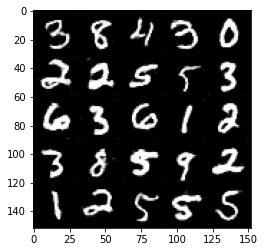

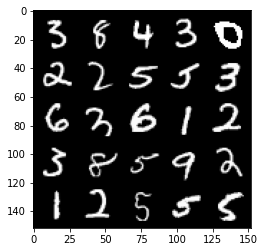

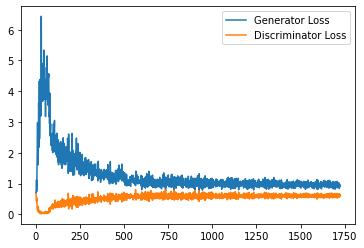

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 74, step 35000: Generator loss: 0.9718025407791138, discriminator loss: 0.599845215857029


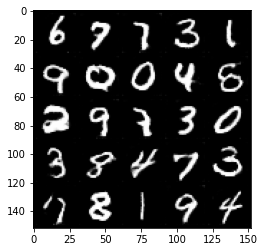

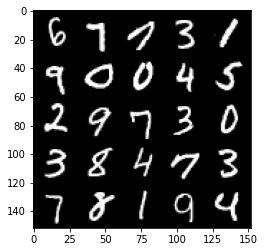

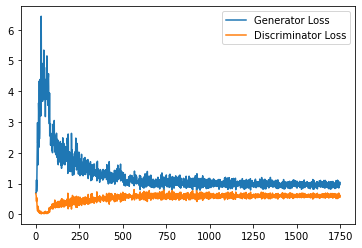

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 75, step 35500: Generator loss: 0.956886188030243, discriminator loss: 0.6035309861302376


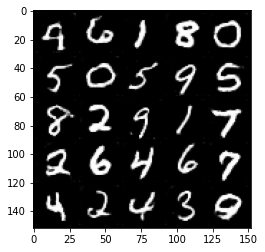

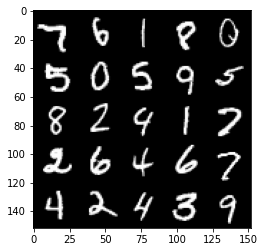

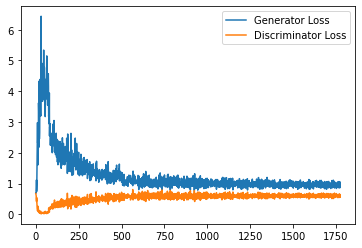

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 76, step 36000: Generator loss: 0.9634522356987, discriminator loss: 0.60317028683424


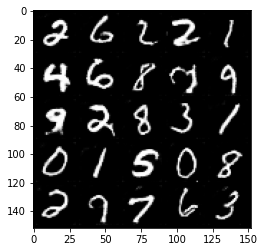

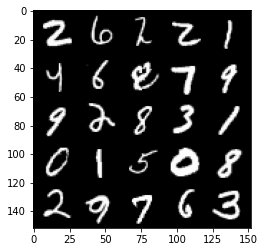

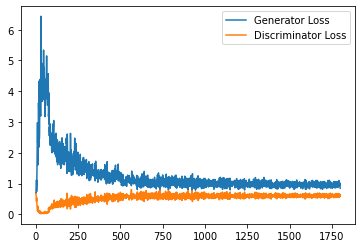

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 77, step 36500: Generator loss: 0.9669607541561127, discriminator loss: 0.6012704652547837


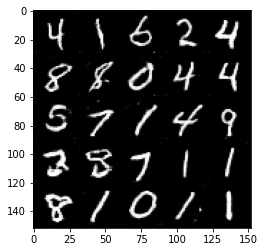

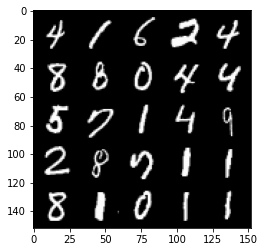

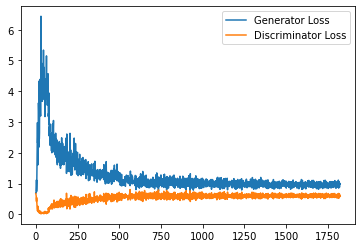

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 78, step 37000: Generator loss: 0.9711788161993027, discriminator loss: 0.6023858895897866


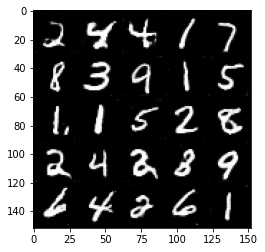

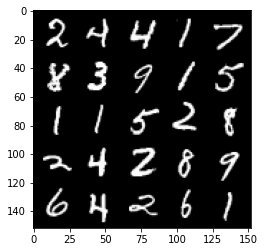

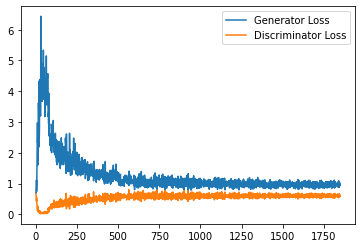

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 79, step 37500: Generator loss: 0.9801997611522675, discriminator loss: 0.6011484993100167


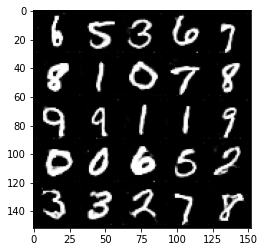

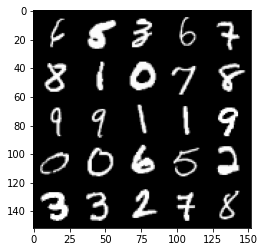

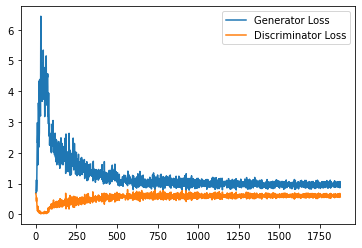

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 81, step 38000: Generator loss: 0.9731984539031983, discriminator loss: 0.6025600560307502


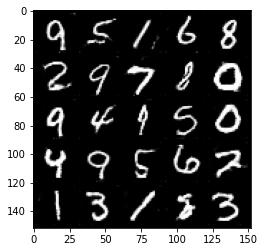

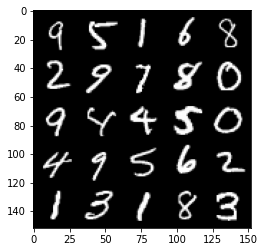

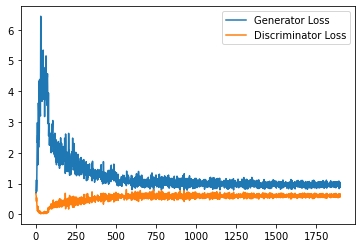

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 82, step 38500: Generator loss: 0.9566538254022598, discriminator loss: 0.6029861961603165


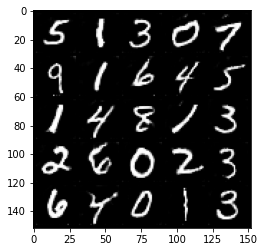

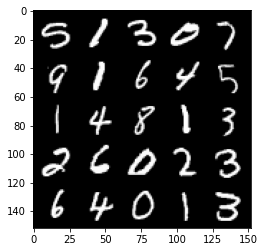

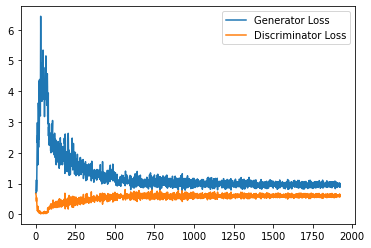

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 83, step 39000: Generator loss: 0.9608669782876968, discriminator loss: 0.5982694003582001


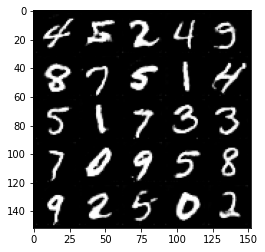

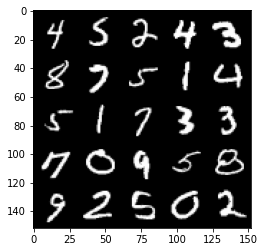

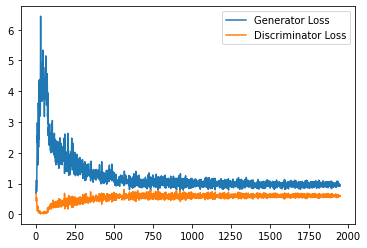

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 84, step 39500: Generator loss: 0.9627575912475586, discriminator loss: 0.5960519050359726


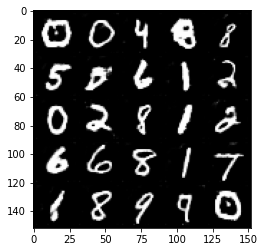

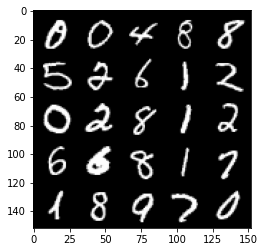

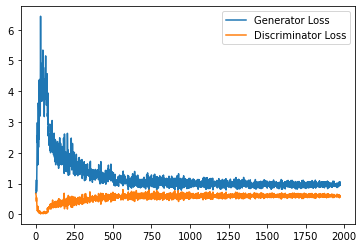

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 85, step 40000: Generator loss: 0.9714581336975098, discriminator loss: 0.6032429716587067


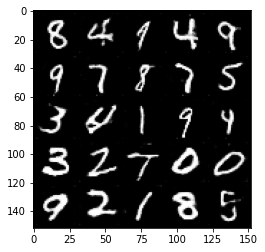

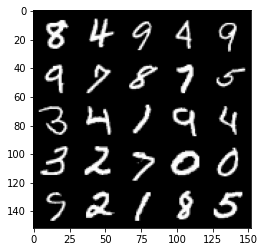

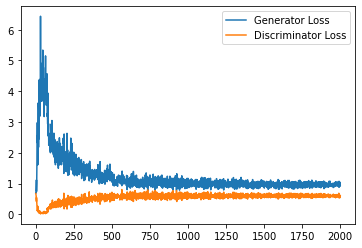

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 86, step 40500: Generator loss: 0.9673320868015289, discriminator loss: 0.6032464480400086


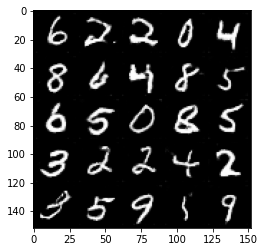

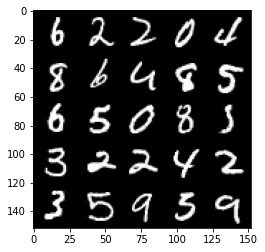

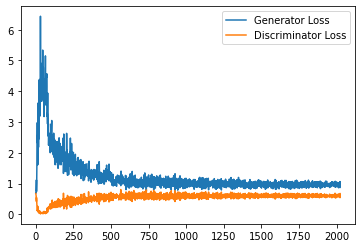

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 87, step 41000: Generator loss: 0.9738588169813156, discriminator loss: 0.5970868723988533


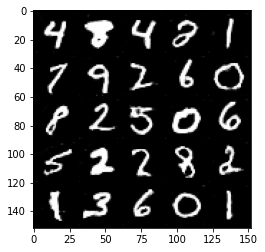

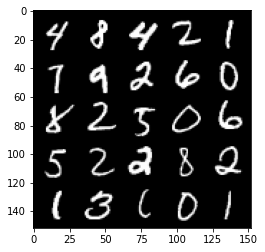

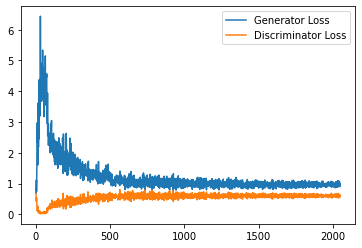

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 88, step 41500: Generator loss: 0.9569207866191864, discriminator loss: 0.5983993001580238


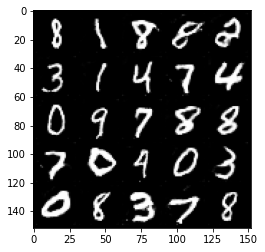

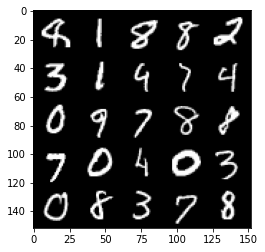

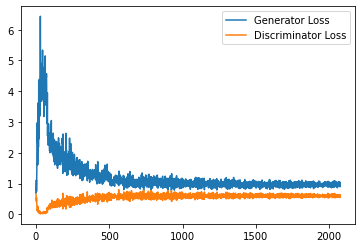

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 89, step 42000: Generator loss: 0.9698579654693603, discriminator loss: 0.5982721962928772


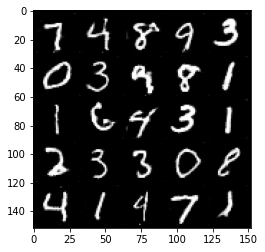

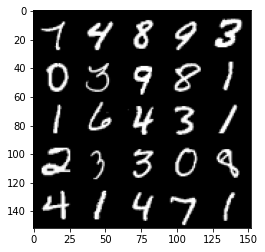

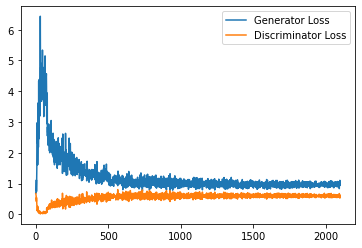

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 90, step 42500: Generator loss: 0.9503979660272598, discriminator loss: 0.6016252735853195


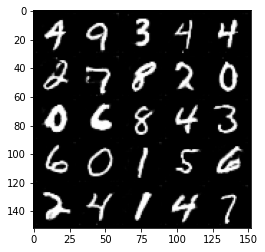

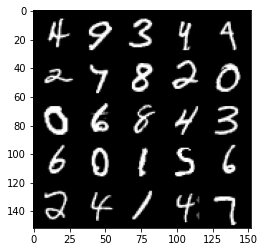

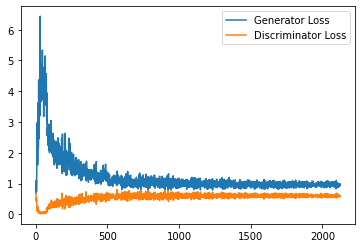

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 91, step 43000: Generator loss: 0.9629513671398163, discriminator loss: 0.5999713139533996


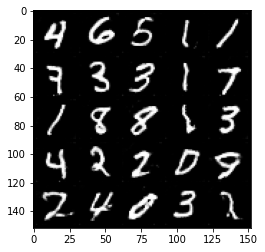

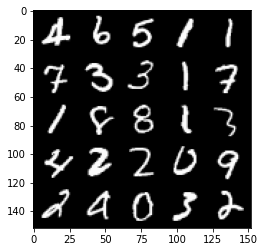

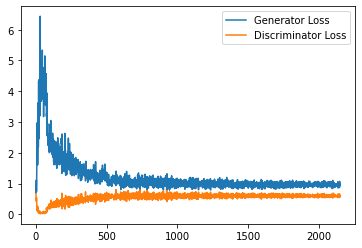

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 92, step 43500: Generator loss: 0.9722429169416428, discriminator loss: 0.5962381120324135


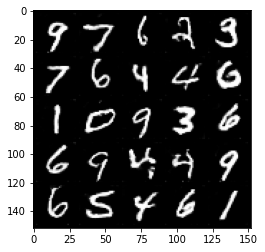

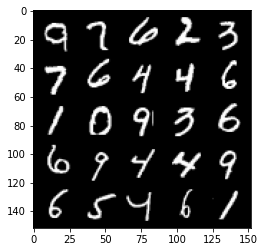

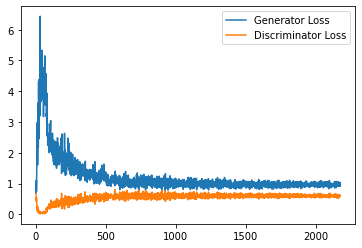

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 93, step 44000: Generator loss: 0.9889556736946106, discriminator loss: 0.5898467382192611


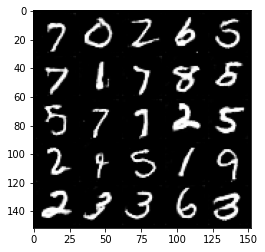

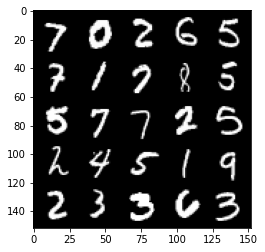

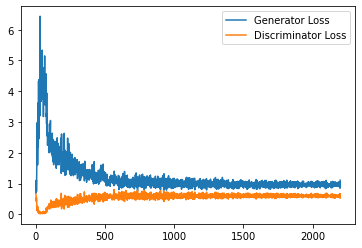

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 94, step 44500: Generator loss: 0.9762551262378693, discriminator loss: 0.5957199930548668


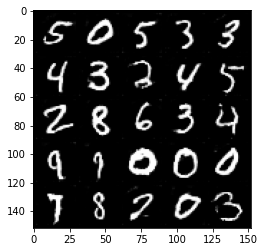

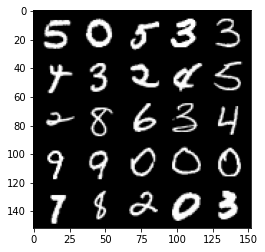

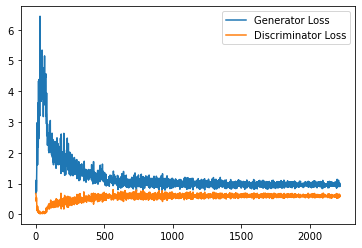

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 95, step 45000: Generator loss: 0.9728924661874772, discriminator loss: 0.5944914856553077


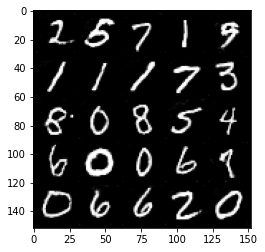

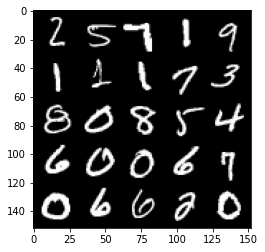

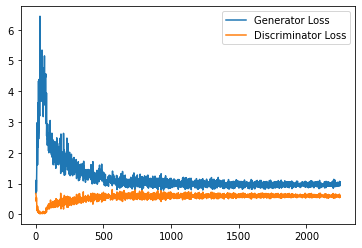

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 97, step 45500: Generator loss: 0.9847205950021743, discriminator loss: 0.5911042469143868


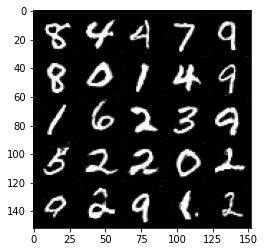

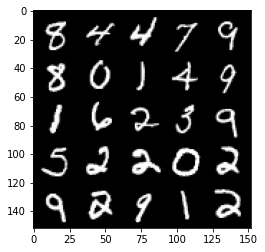

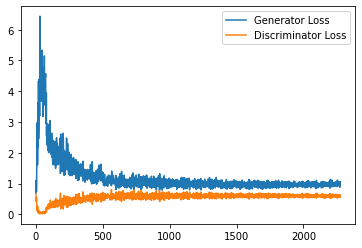

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 98, step 46000: Generator loss: 0.9782602227926255, discriminator loss: 0.5968915303349495


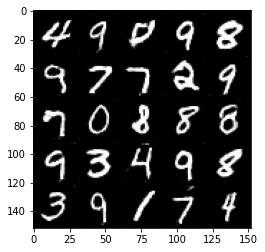

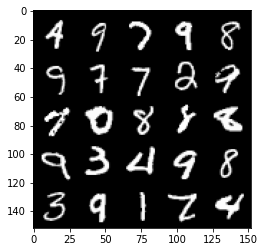

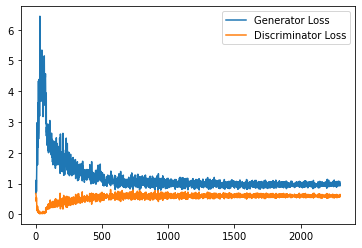

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 99, step 46500: Generator loss: 0.9672302802801133, discriminator loss: 0.59691135764122


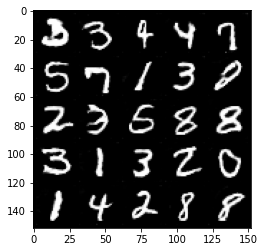

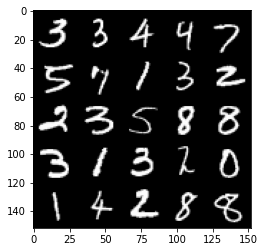

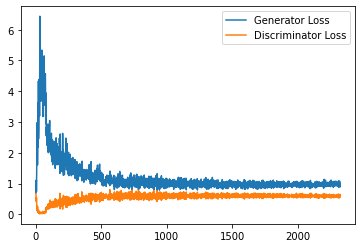

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 100, step 47000: Generator loss: 0.9692915061712265, discriminator loss: 0.593487067103386


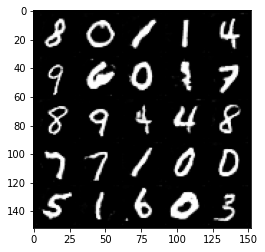

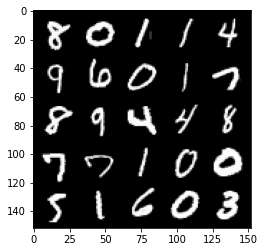

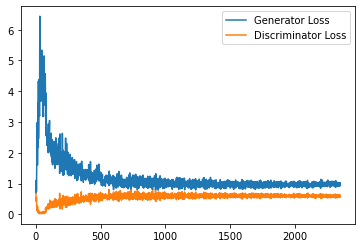

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 101, step 47500: Generator loss: 0.9886472609043121, discriminator loss: 0.5905243059992791


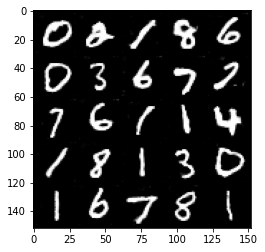

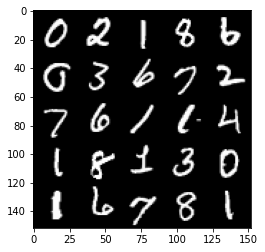

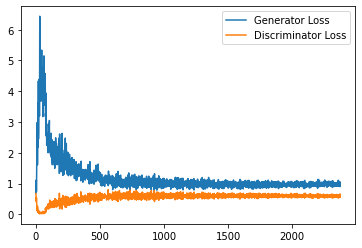

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 102, step 48000: Generator loss: 0.9962272709608078, discriminator loss: 0.5943968378901482


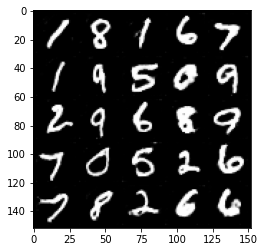

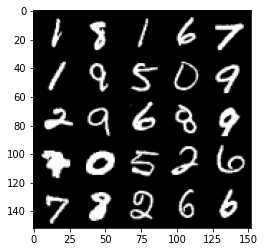

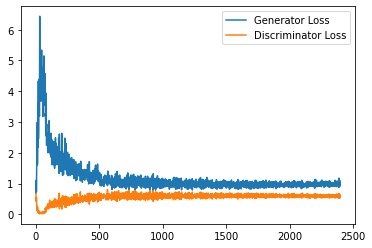

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 103, step 48500: Generator loss: 0.9775677978992462, discriminator loss: 0.5908082273602485


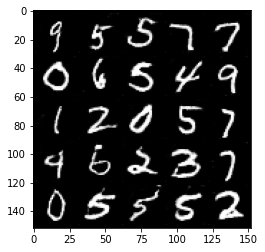

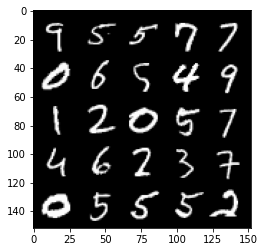

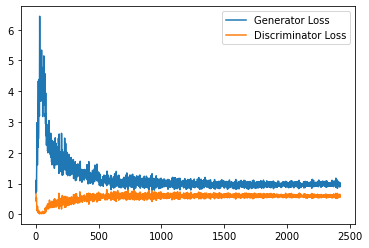

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 104, step 49000: Generator loss: 0.9831782903671265, discriminator loss: 0.5883335380554199


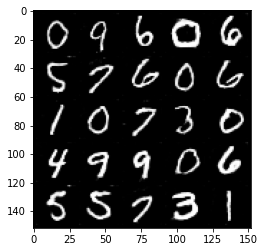

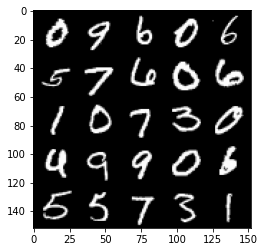

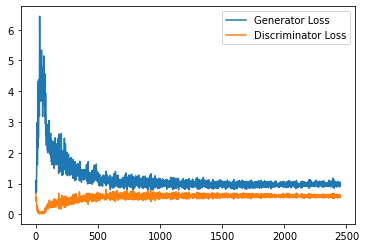

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 105, step 49500: Generator loss: 0.98801509308815, discriminator loss: 0.5913798878788948


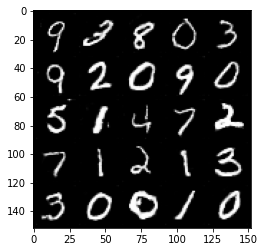

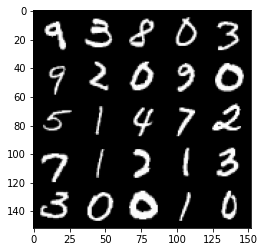

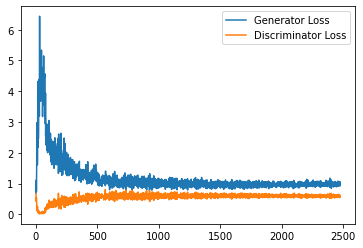

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 106, step 50000: Generator loss: 0.990081891655922, discriminator loss: 0.5898941267132759


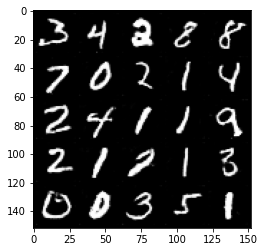

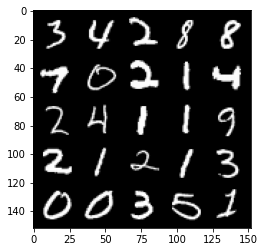

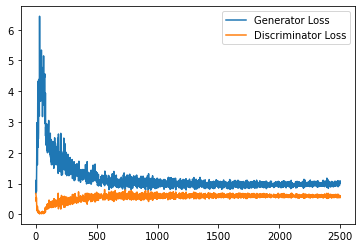

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 107, step 50500: Generator loss: 0.978434569478035, discriminator loss: 0.5932991194725037


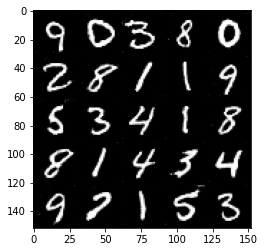

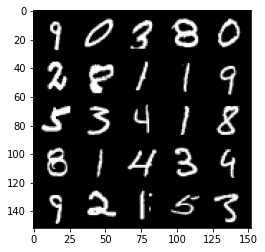

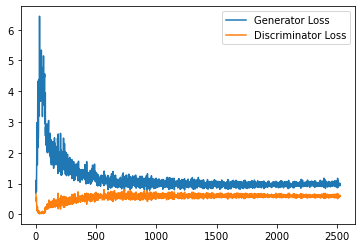

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 108, step 51000: Generator loss: 0.9889836106300354, discriminator loss: 0.5907562304139137


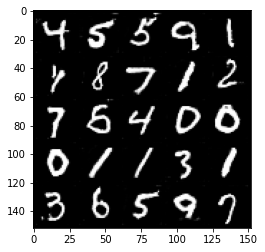

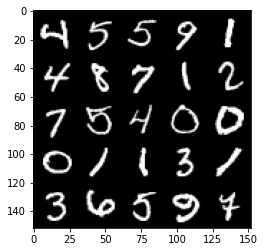

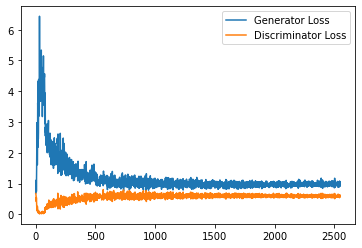

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 109, step 51500: Generator loss: 0.9886786984205246, discriminator loss: 0.5947235520482064


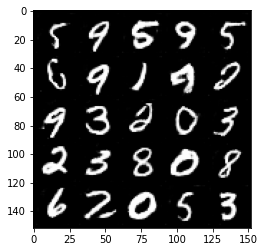

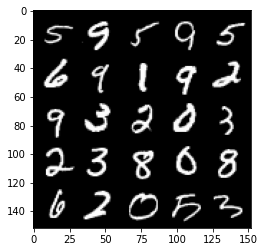

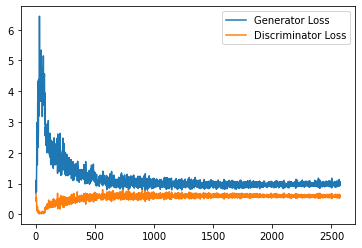

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 110, step 52000: Generator loss: 0.9860964639186859, discriminator loss: 0.5917323362827301


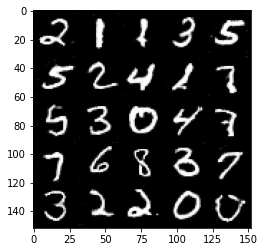

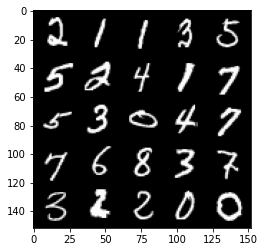

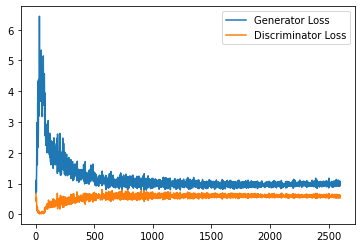

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 111, step 52500: Generator loss: 0.9824254457950592, discriminator loss: 0.5921820728182793


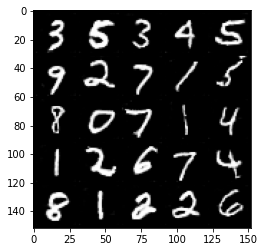

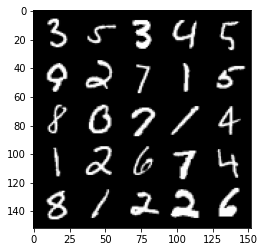

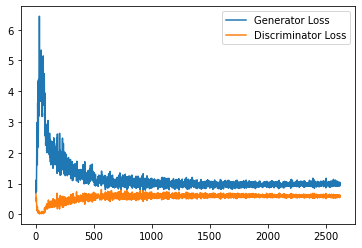

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 113, step 53000: Generator loss: 0.9871044970750809, discriminator loss: 0.5915544673204421


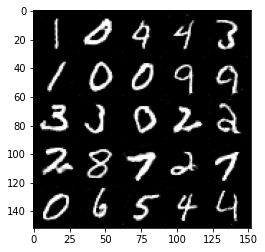

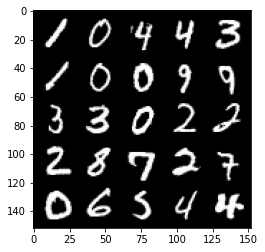

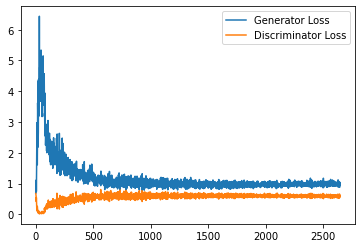

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 114, step 53500: Generator loss: 1.0009003386497497, discriminator loss: 0.5891015724539757


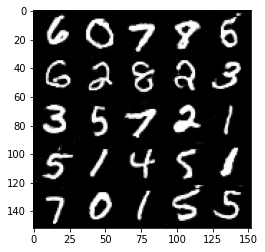

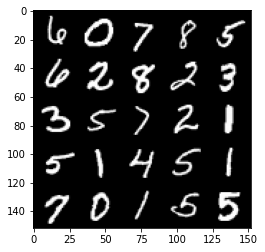

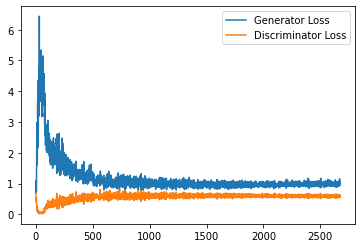

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 115, step 54000: Generator loss: 0.9868454908132553, discriminator loss: 0.5900873950719834


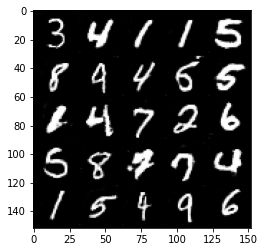

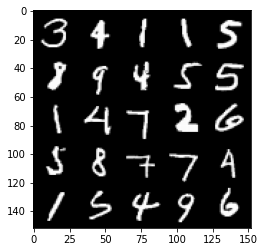

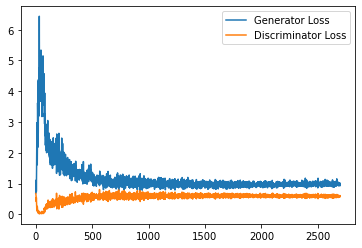

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 116, step 54500: Generator loss: 0.9845499460697174, discriminator loss: 0.5875280858278275


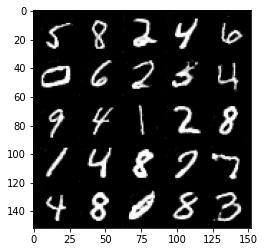

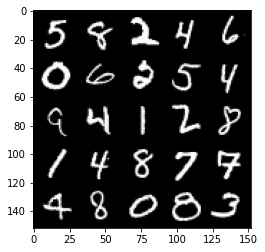

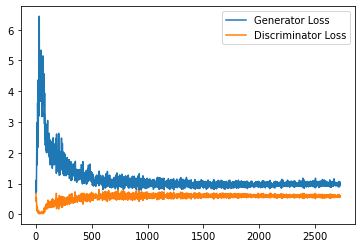

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 117, step 55000: Generator loss: 0.988080124616623, discriminator loss: 0.5907596276402474


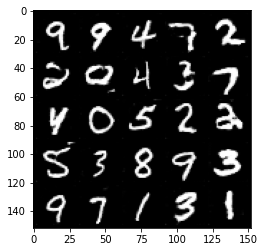

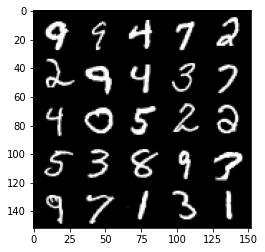

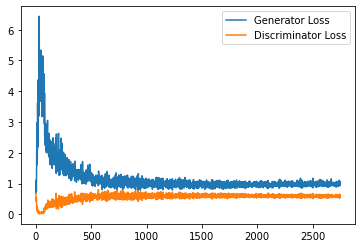

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 118, step 55500: Generator loss: 0.995301910161972, discriminator loss: 0.5903307056427002


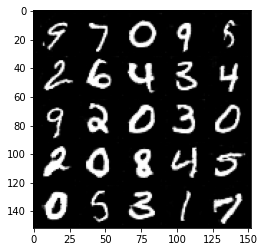

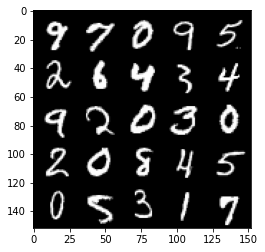

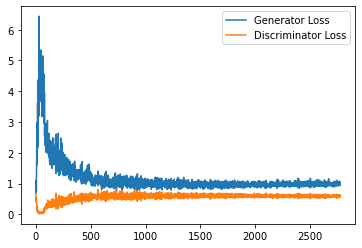

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 119, step 56000: Generator loss: 0.9984353108406067, discriminator loss: 0.5869345993995666


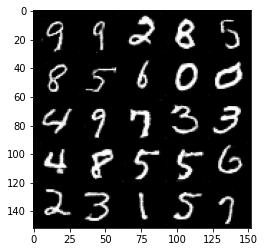

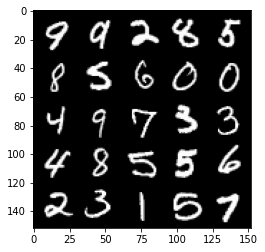

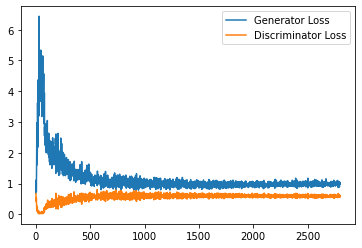

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 120, step 56500: Generator loss: 0.9928845608234406, discriminator loss: 0.590484310567379


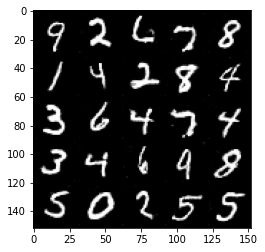

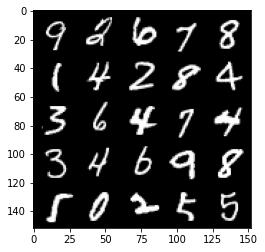

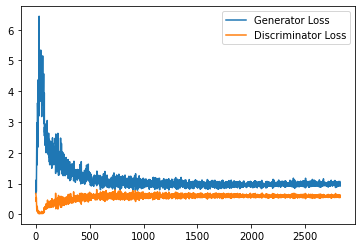

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 121, step 57000: Generator loss: 0.9947649408578872, discriminator loss: 0.5909679229259491


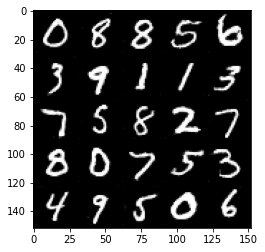

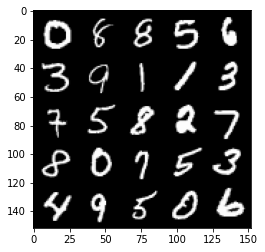

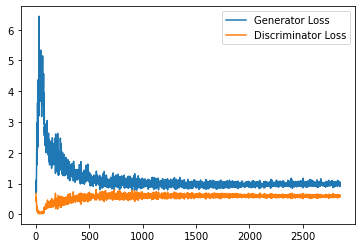

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 122, step 57500: Generator loss: 0.9915384154319763, discriminator loss: 0.591434233546257


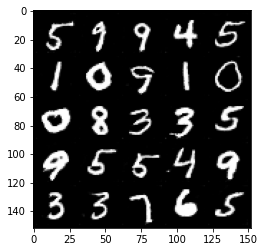

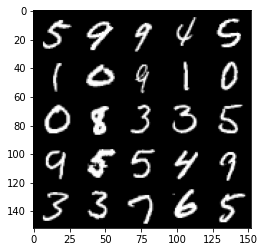

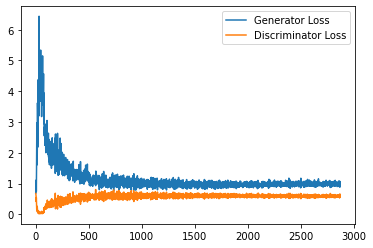

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 123, step 58000: Generator loss: 1.00266362285614, discriminator loss: 0.5904977090358734


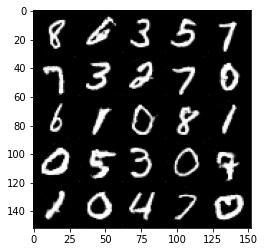

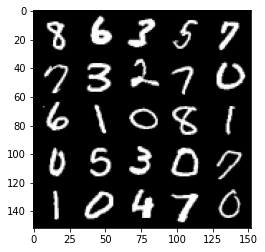

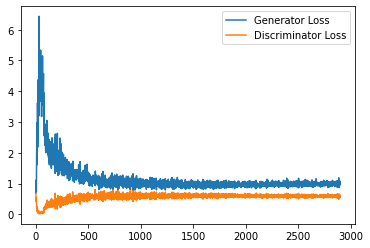

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 124, step 58500: Generator loss: 0.9961457625627518, discriminator loss: 0.5939294757843018


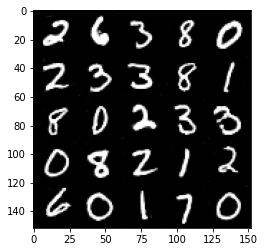

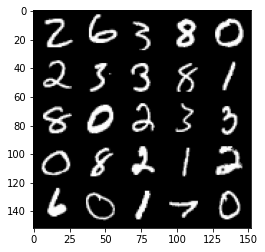

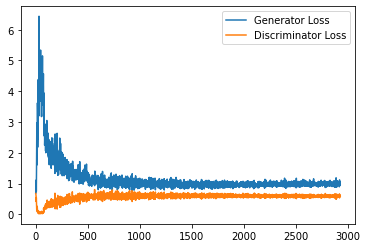

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 125, step 59000: Generator loss: 0.9805822938680648, discriminator loss: 0.590554819226265


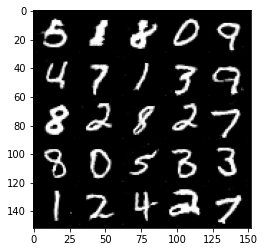

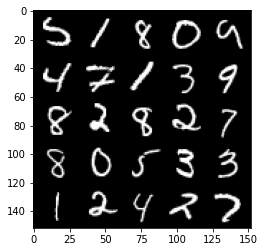

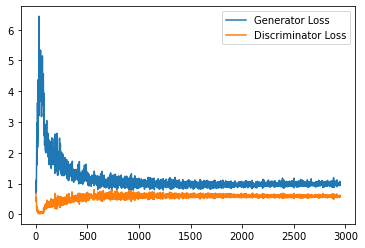

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 126, step 59500: Generator loss: 1.0051537498235703, discriminator loss: 0.5889823120832444


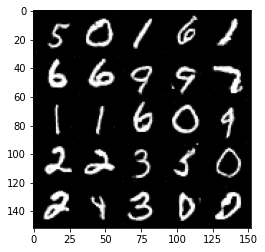

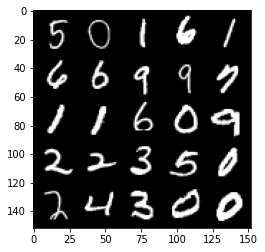

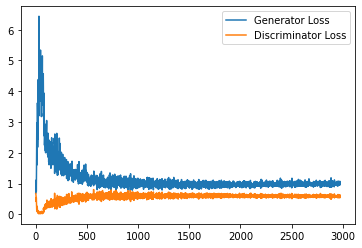

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 127, step 60000: Generator loss: 0.9878640104532241, discriminator loss: 0.5964580356478691


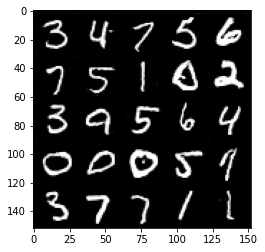

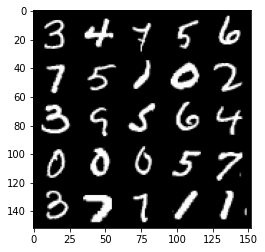

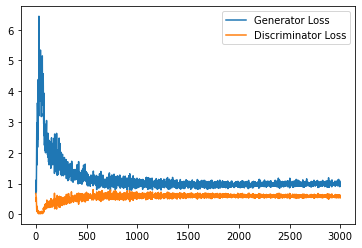

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 128, step 60500: Generator loss: 0.9716082414388657, discriminator loss: 0.5955674307346344


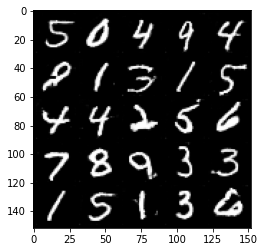

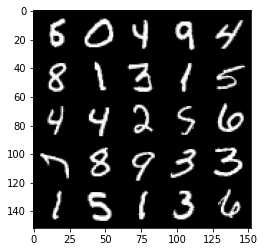

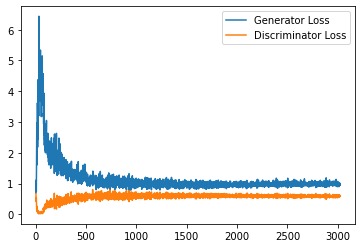

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 130, step 61000: Generator loss: 0.9823872505426406, discriminator loss: 0.5918795783519745


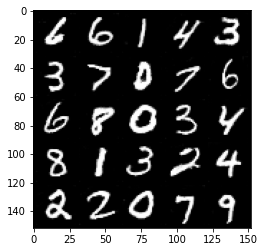

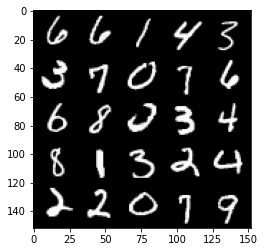

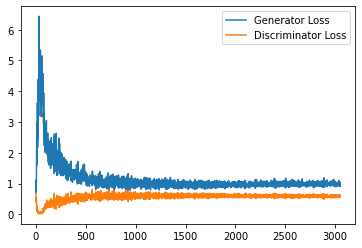

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 131, step 61500: Generator loss: 0.9875438742637634, discriminator loss: 0.5948403127193451


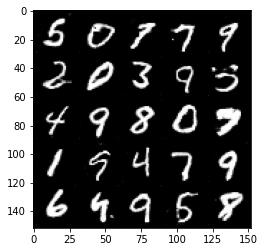

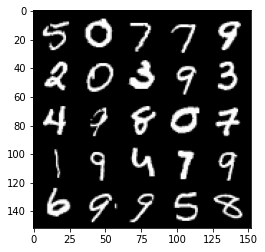

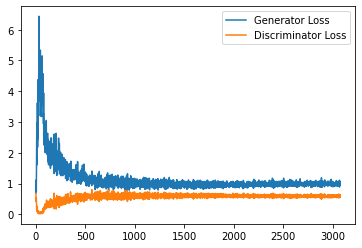

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 132, step 62000: Generator loss: 0.9932070163488388, discriminator loss: 0.5933504705429077


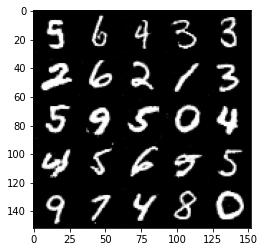

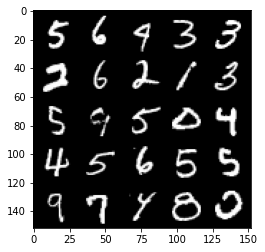

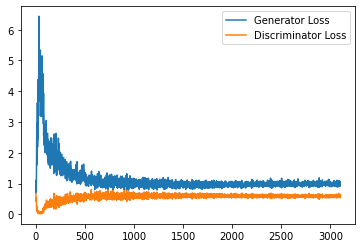

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 133, step 62500: Generator loss: 0.9857762658596039, discriminator loss: 0.5959470272064209


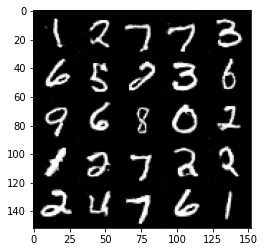

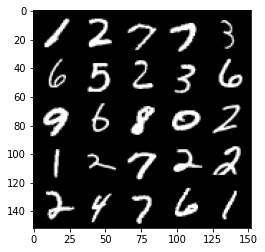

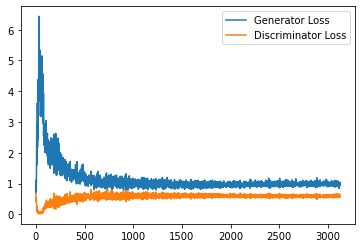

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 134, step 63000: Generator loss: 0.9893739488124847, discriminator loss: 0.5987810736894608


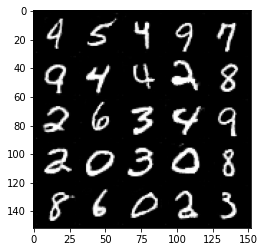

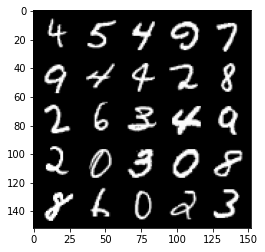

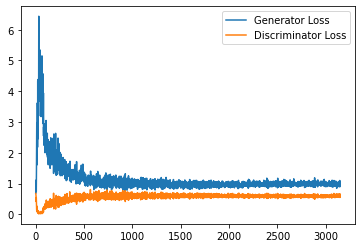

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 135, step 63500: Generator loss: 0.9857104165554047, discriminator loss: 0.5990949251055717


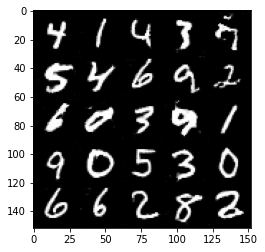

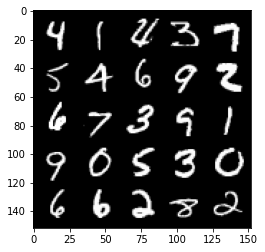

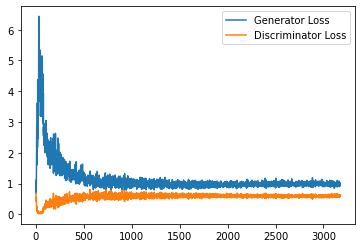

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 136, step 64000: Generator loss: 0.9907590901851654, discriminator loss: 0.5992328925132752


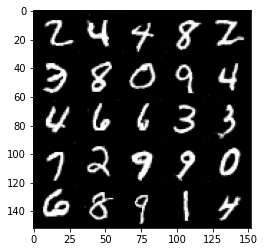

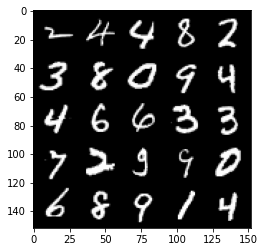

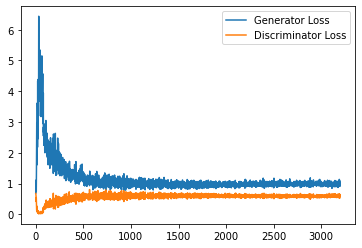

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 137, step 64500: Generator loss: 0.9791338996887207, discriminator loss: 0.5985516993403435


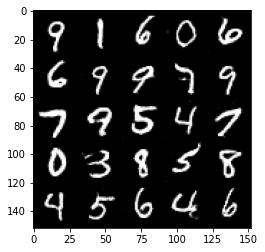

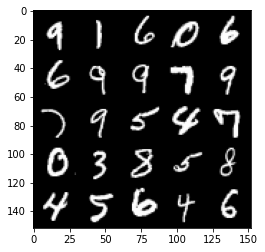

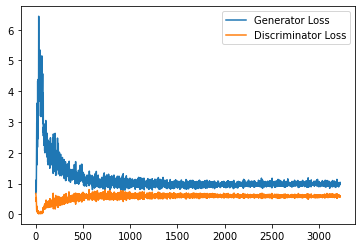

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 138, step 65000: Generator loss: 0.9988668788671493, discriminator loss: 0.5939182577729225


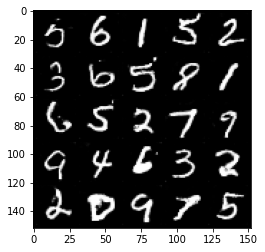

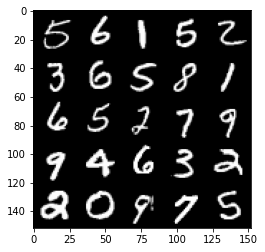

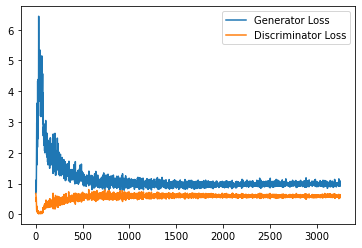

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 139, step 65500: Generator loss: 0.9884971903562546, discriminator loss: 0.6033154882192612


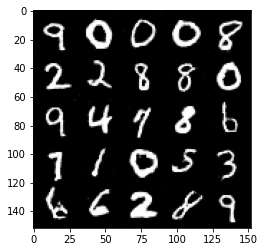

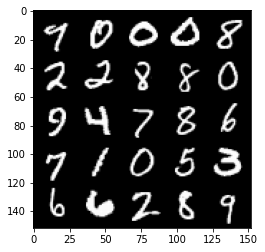

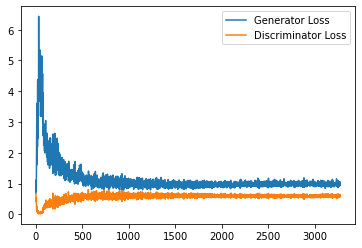

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 140, step 66000: Generator loss: 0.9791118314266205, discriminator loss: 0.601351691365242


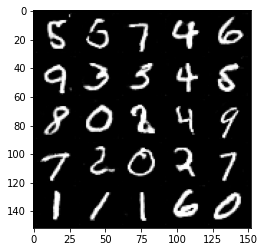

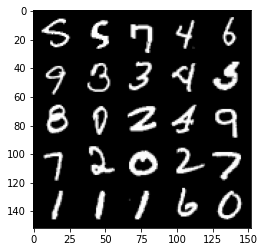

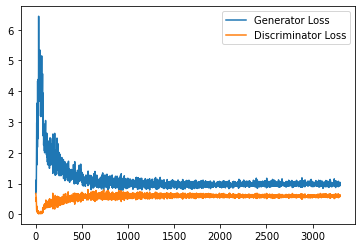

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 141, step 66500: Generator loss: 0.9681712248325348, discriminator loss: 0.5992387850284576


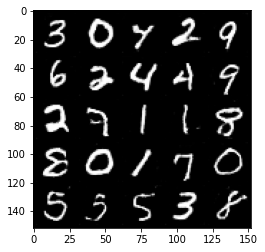

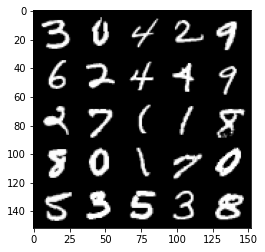

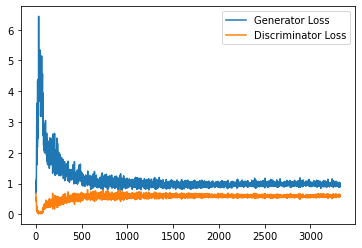

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 142, step 67000: Generator loss: 0.9726955980062485, discriminator loss: 0.6011915320754051


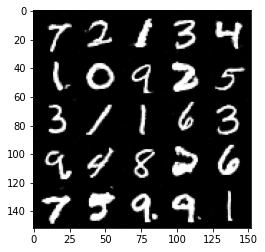

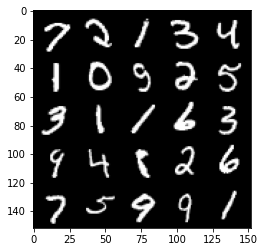

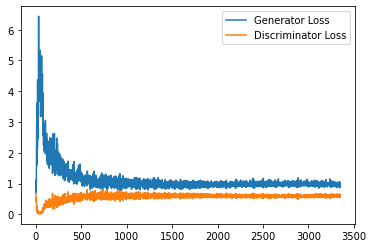

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 143, step 67500: Generator loss: 0.9874613311290741, discriminator loss: 0.5991132476329804


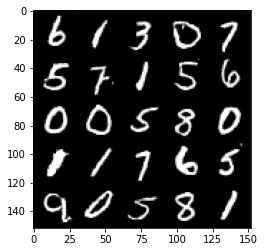

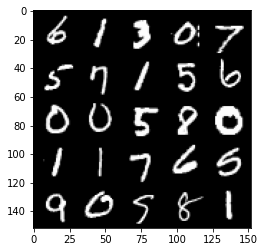

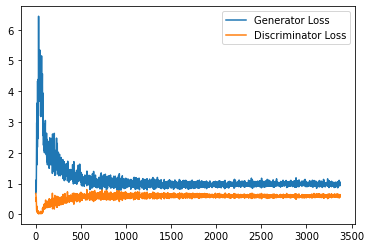

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 144, step 68000: Generator loss: 0.9800759843587875, discriminator loss: 0.6010876988172531


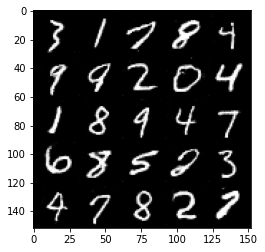

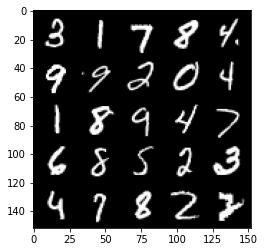

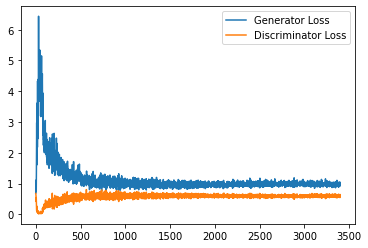

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 146, step 68500: Generator loss: 0.9813269224166871, discriminator loss: 0.6027975353002548


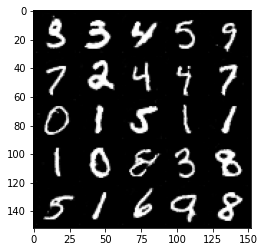

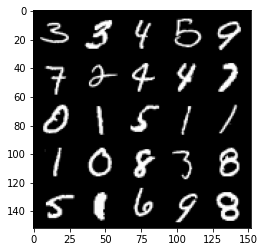

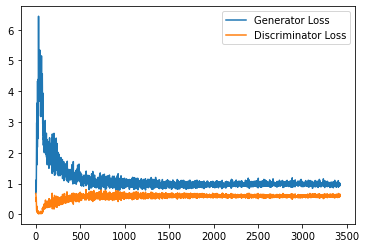

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 147, step 69000: Generator loss: 0.9824249728918075, discriminator loss: 0.5997054933309555


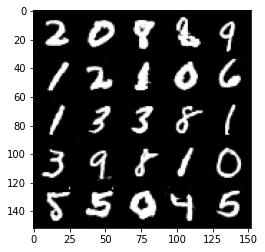

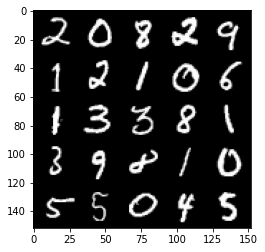

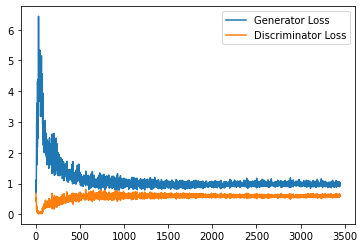

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 148, step 69500: Generator loss: 0.9841988662481308, discriminator loss: 0.6075005660653114


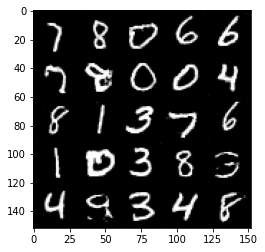

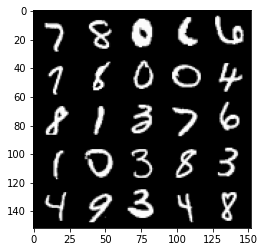

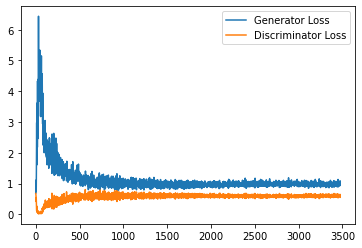

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 149, step 70000: Generator loss: 0.9822823369503021, discriminator loss: 0.6062913618683815


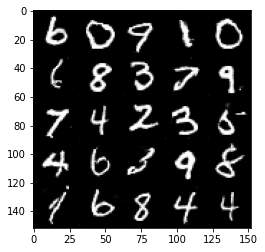

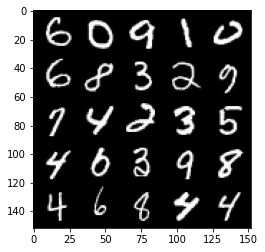

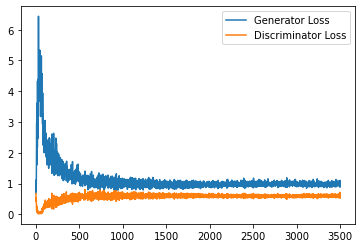

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 150, step 70500: Generator loss: 0.9803098077774048, discriminator loss: 0.603043981909752


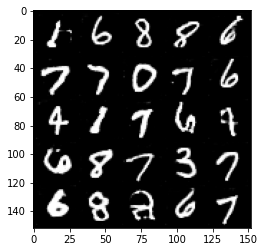

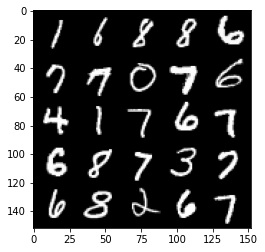

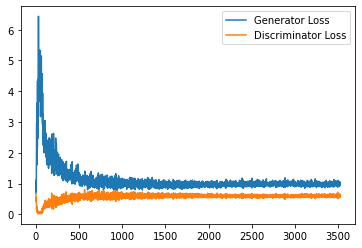

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 151, step 71000: Generator loss: 0.9761519581079483, discriminator loss: 0.6027237459421158


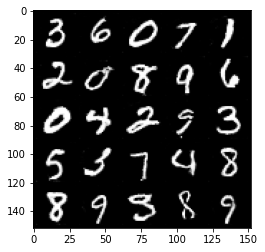

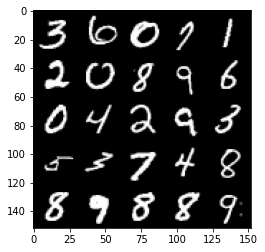

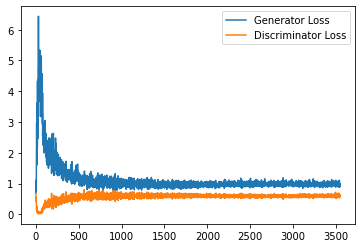

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 152, step 71500: Generator loss: 0.9706122088432312, discriminator loss: 0.6086035761833191


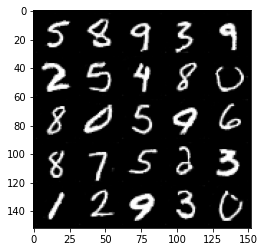

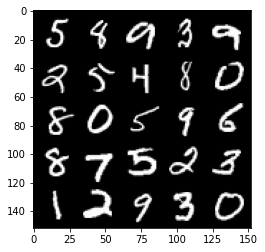

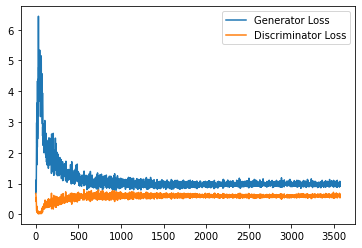

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 153, step 72000: Generator loss: 0.9574497604370117, discriminator loss: 0.6033602245450019


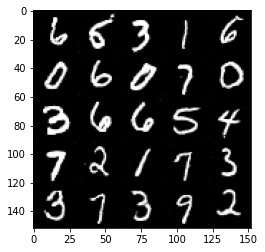

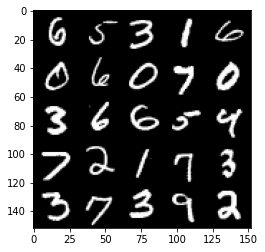

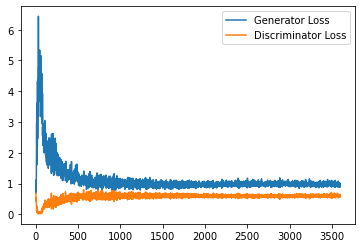

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 154, step 72500: Generator loss: 0.967349175453186, discriminator loss: 0.6055369554162026


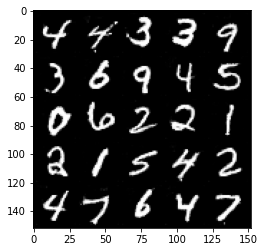

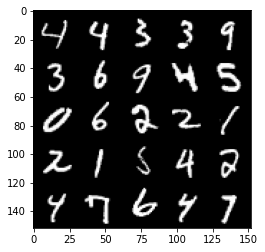

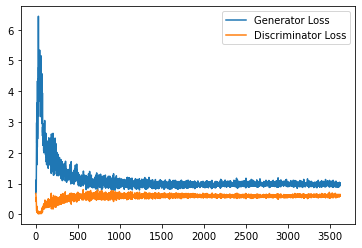

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 155, step 73000: Generator loss: 0.9854121564626693, discriminator loss: 0.6012273701429367


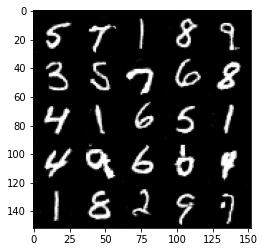

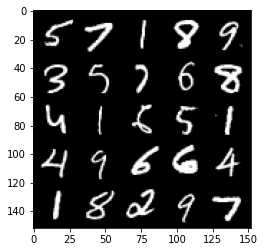

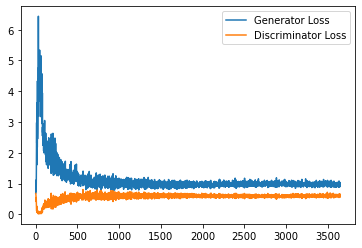

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 156, step 73500: Generator loss: 0.9706636196374894, discriminator loss: 0.6066840981245041


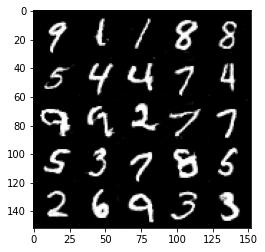

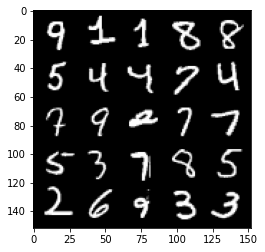

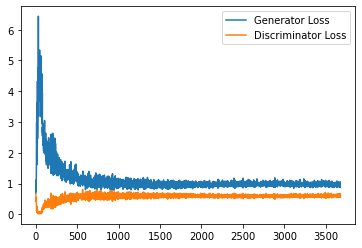

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 157, step 74000: Generator loss: 0.9754232144355774, discriminator loss: 0.6037971289753914


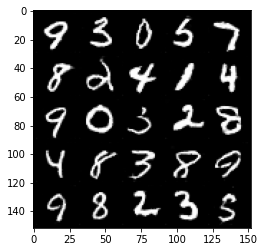

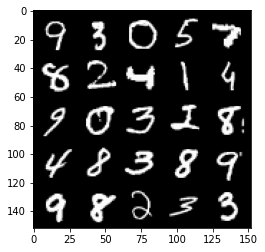

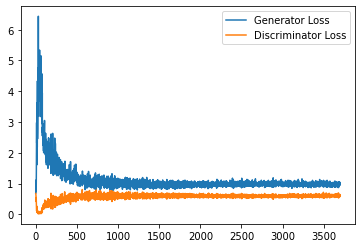

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 158, step 74500: Generator loss: 0.9659128570556641, discriminator loss: 0.6088749668002129


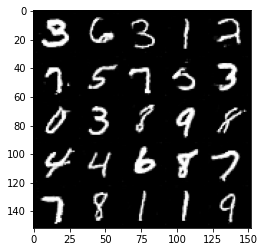

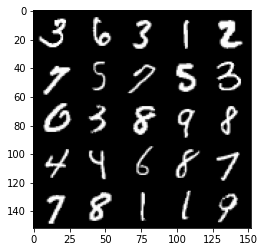

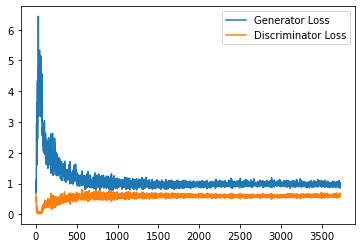

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 159, step 75000: Generator loss: 0.9811555459499359, discriminator loss: 0.606400476694107


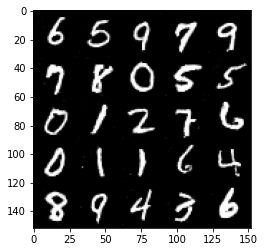

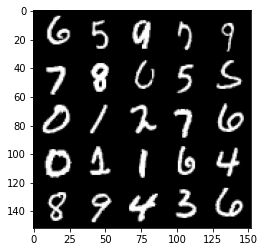

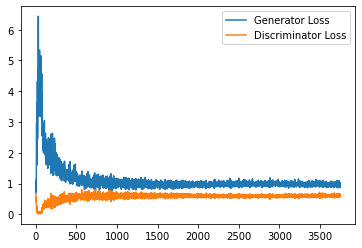

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 160, step 75500: Generator loss: 0.9872401487827301, discriminator loss: 0.6036418831944466


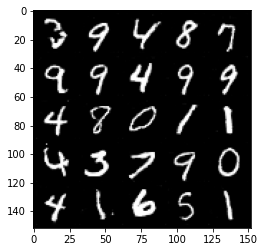

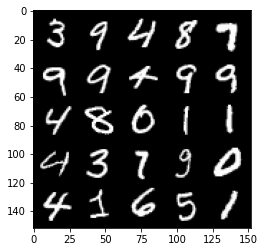

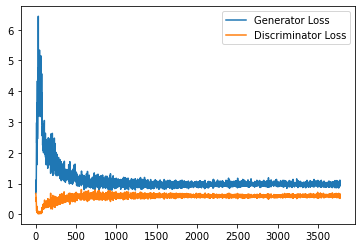

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 162, step 76000: Generator loss: 0.9616881222724915, discriminator loss: 0.604649296939373


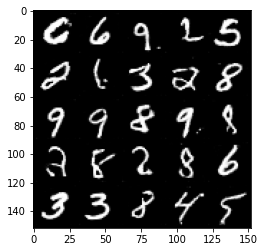

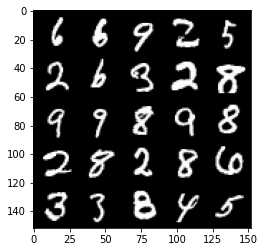

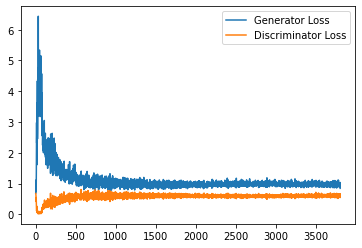

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 163, step 76500: Generator loss: 0.9740197720527649, discriminator loss: 0.6035290776491166


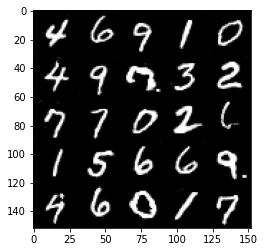

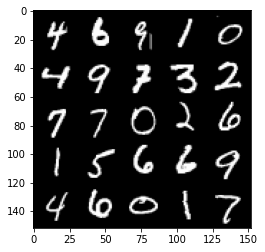

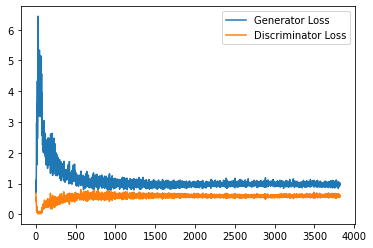

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 164, step 77000: Generator loss: 0.979280129313469, discriminator loss: 0.606476828634739


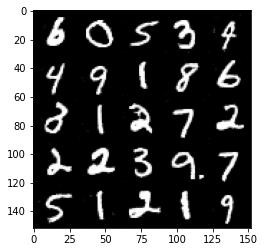

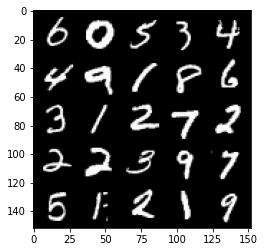

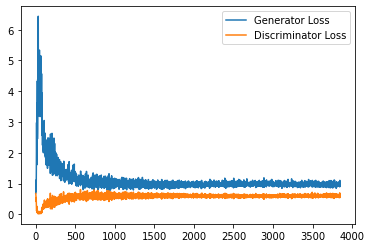

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 165, step 77500: Generator loss: 0.9735683062076569, discriminator loss: 0.6077450959086418


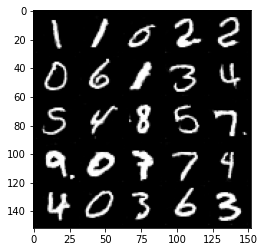

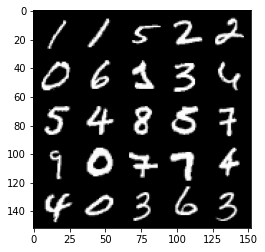

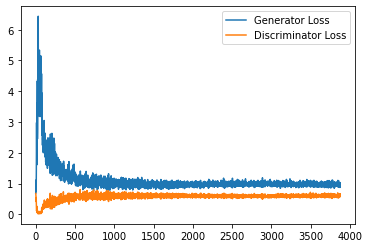

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 166, step 78000: Generator loss: 0.9783477793931961, discriminator loss: 0.6089904655814171


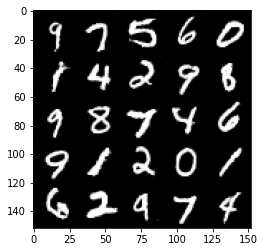

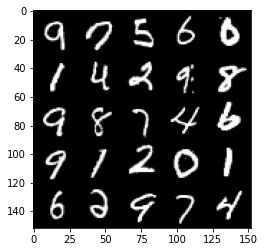

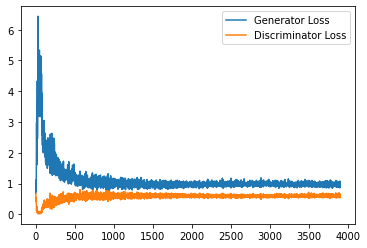

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 167, step 78500: Generator loss: 0.9873220117092133, discriminator loss: 0.6073655254840851


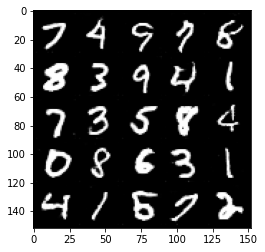

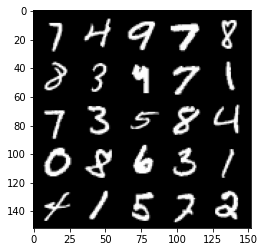

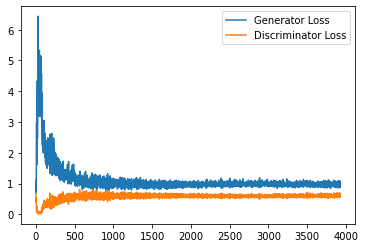

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 168, step 79000: Generator loss: 0.9760717862844467, discriminator loss: 0.6080700343847275


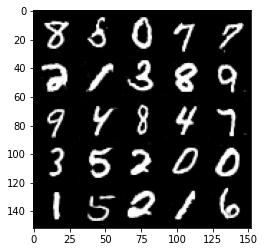

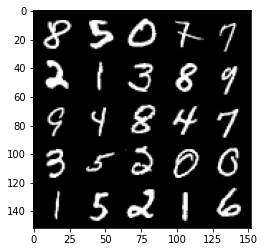

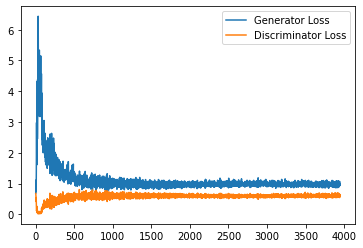

In [13]:
cur_step = 0
generator_losses = []
discriminator_losses = []

noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader devuelve los lotes y las etiquetas
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Aplane el lote de imágenes reales del conjunto de datos
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Actualizar el discriminador ###
        # Poner a cero los gradientes del discriminador
        disc_opt.zero_grad()
        # Obtenga el ruido correspondiente al tamaño del lote actual
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Ahora puedes obtener las imágenes del generador.
        # Pasos: 1) Combine los vectores de ruido y las etiquetas one-hot para el generador
        #        2) Generar las imágenes falsas condicionadas
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Asegúrese de que se generaron suficientes imágenes
        assert len(fake) == len(real)
        # Compruebe que se combinaron los tensores correctos
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # Viene del generador correcto.
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Ahora puedes obtener las predicciones del discriminador
         # Pasos: 1) Crear la entrada para el discriminador
         #          a) Combina las imágenes falsas con image_one_hot_labels,
         #             recuerde desconectar el generador (.detach()) para que no se propague hacia atrás a través de él
         #          b) Combinar las imágenes reales con image_one_hot_labels
         #        2) Obtenga la predicción del discriminador sobre las falsificaciones como disc_fake_pred
         #        3) Obtener la predicción del discriminador sobre los reales como disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake.detach(), image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Asegúrese de que las formas sean correctas
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Asegúrese de que se hayan hecho suficientes predicciones
        assert len(disc_real_pred) == len(real)
        # Asegúrate de que las entradas sean diferentes.
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Las formas deben coincidir
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Realice un seguimiento de la pérdida promedio del discriminador
        discriminator_losses += [disc_loss.item()]

        ### Actualizar el generador ###
        # Poner a cero los gradientes del generador
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # Esto generará un error si no concatenó sus etiquetas a su imagen correctamente
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Lleve un registro de las pérdidas del generador
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Epoch {epoch}, step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1